# Predict Conversion Rate E-Commerce Insight by Using Machine Learning

## Latar Belakang
Proyek akhir ini berfokus pada analisis dan prediksi niat pembelian pengunjung online di indust dilakukan melalui platform Amazon Mechanical Turk. Survei ini menggambarkan berbagai skenario berkendara, termasuk tujuan, waktu saat ini, cuaca, penumpang, dan lain-lain. Responden diminta untuk menentukan apakah mereka akan menerima kupon jika mereka adalah pengemudi.ri e-commerce. Data yang digunakan dalam proyek ini telah dikumpulkan melalui survei.

## Problem
Pengunjung pada platform E-Commerce yang menghasilkan pendapatan hanya 2.008 dari keseluruhan data 12.946 (15.51%).

## Goal
Meningkatkan persentase Visitor yang menghasilkan Revenue pada Platform E-Commerce.

## Objective
Membuat suatu model yang dapat memprediksi apakah Visitor akan menyelesaikan transaksi dan menghasilkan revenue atau tidak, berdasarkan perilaku/karakteristik visitor.

## Business Metrics
`Conversion rate`: Persentase pengunjung yang melakukan transaksi dan menyelesaikannya.

## Data
'dataset.csv'


## Import Library

In [1]:
# Import library
import warnings
warnings.filterwarnings('ignore')

# for manipulation data (processing)
import pandas as pd
import numpy as np 
import ppscore as pps
import datetime as dt
from datetime import date
from datetime import datetime as dt

# for visualization
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.style as style
import seaborn as sns

# for EDA
import dataprep
from dataprep.eda import plot_missing
from dataprep.eda import create_report

# for machine learning
import sklearn
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, GridSearchCV, RandomizedSearchCV, cross_validate
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, recall_score, precision_score, f1_score, auc, roc_auc_score

# for visualization of feature importance
import shap

## Load Dataset

In [2]:
df = pd.read_csv('dataset.csv')
df.sample(5)

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
12622,1.0,6.0,0,0.0,2,15.000000,0.000000,0.066667,0.0,0.0,Oct,NaN,2,9,4,Returning_Visitor,False,False
7816,0.0,0.0,0,0.0,13,70.400000,0.138462,0.143590,0.0,0.0,Aug,2.0,2,2,13,Returning_Visitor,False,False
528,0.0,0.0,0,0.0,9,104.833333,0.022222,0.072222,0.0,0.0,Mar,2.0,2,4,2,Returning_Visitor,False,False
4722,1.0,4.0,0,0.0,13,161.166667,0.024615,0.061538,0.0,0.6,May,2.0,5,9,5,Returning_Visitor,False,False
3609,0.0,0.0,0,0.0,14,180.500000,0.085714,0.092143,0.0,0.0,May,3.0,2,1,13,Returning_Visitor,False,False


## Exploratory Data Analysis

### Descriptive Statistics

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12946 entries, 0 to 12945
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           12835 non-null  float64
 1   Administrative_Duration  12313 non-null  float64
 2   Informational            12946 non-null  int64  
 3   Informational_Duration   12946 non-null  float64
 4   ProductRelated           12946 non-null  int64  
 5   ProductRelated_Duration  12307 non-null  float64
 6   BounceRates              12872 non-null  float64
 7   ExitRates                12946 non-null  float64
 8   PageValues               12946 non-null  float64
 9   SpecialDay               12946 non-null  float64
 10  Month                    12946 non-null  object 
 11  OperatingSystems         12422 non-null  float64
 12  Browser                  12946 non-null  int64  
 13  Region                   12946 non-null  int64  
 14  TrafficType           

A. Apakah ada kolom dengan tipe data kurang sesuai, atau nama kolom dan isinya kurang sesuai?

Tidak ada

### Nilai yang kosong

  0%|          | 0/206 [00:00<?, ?it/s]


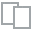
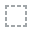
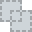
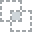
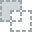
...
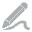
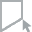
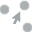
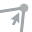
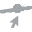

In [4]:
plot_missing(df)

B. Apakah ada kolom yang memiliki nilai kosong? Jika ada, apa saja? \
Iya, kolom yang kosong `Administrative`, `Administrative_Duration`, `ProductRelated_Duration`, `BounceRates`, dan `OperatingSystems`

## Statsitika Deskriptif

### Data Numerik

In [5]:
# make a list of numerical data
nums = list(df.select_dtypes(['int64','float64']))
nums

['Administrative',
 'Administrative_Duration',
 'Informational',
 'Informational_Duration',
 'ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues',
 'SpecialDay',
 'OperatingSystems',
 'Browser',
 'Region',
 'TrafficType']

In [6]:
df.select_dtypes(['int64','float64']).describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,OperatingSystems,Browser,Region,TrafficType
count,12835.000000,12313.000000,12946.000000,12946.000000,12946.000000,12307.000000,12872.000000,12946.000000,12946.000000,12946.000000,12422.000000,12946.000000,12946.000000,12946.000000
mean,2.303857,80.370267,0.498841,34.136048,31.657655,1192.740077,0.022309,0.043266,5.875963,0.061270,2.123169,2.360497,3.144369,4.078248
std,3.314427,175.494016,1.263276,140.022848,44.202635,1910.216261,0.048681,0.048808,18.414670,0.198667,0.906264,1.718878,2.402477,4.025467
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,7.000000,182.083333,0.000000,0.014286,0.000000,0.000000,2.000000,2.000000,1.000000,2.000000
50%,1.000000,7.000000,0.000000,0.000000,18.000000,599.583333,0.003112,0.025329,0.000000,0.000000,2.000000,2.000000,3.000000,2.000000
75%,4.000000,92.933333,0.000000,0.000000,38.000000,1470.522917,0.016933,0.050000,0.000000,0.000000,3.000000,2.000000,4.000000,4.000000
max,27.000000,3398.750000,24.000000,2549.375000,705.000000,63973.522230,0.200000,0.200000,361.763742,1.000000,8.000000,13.000000,9.000000,20.000000


In [7]:
for i in nums:
    print(f"\nValue count kolom {i}:\n{(19+len(i))*'='}")
    print(df[i].value_counts())


Value count kolom Administrative:
0.0     6020
1.0     1412
2.0     1171
3.0      944
4.0      786
5.0      599
6.0      450
7.0      345
8.0      300
9.0      234
10.0     158
11.0     106
12.0      90
13.0      57
14.0      45
15.0      39
16.0      26
17.0      16
18.0      14
19.0       6
24.0       4
22.0       4
23.0       3
21.0       2
20.0       2
27.0       1
26.0       1
Name: Administrative, dtype: int64

Value count kolom Administrative_Duration:
0.000000       5893
4.000000         55
5.000000         54
7.000000         45
11.000000        42
               ... 
1013.171429       1
191.200000        1
92.571429         1
112.900000        1
150.357143        1
Name: Administrative_Duration, Length: 3223, dtype: int64

Value count kolom Informational:
0     10202
1      1087
2       760
3       401
4       228
5       103
6        81
7        36
9        15
8        14
10        7
12        5
14        3
16        1
11        1
24        1
13        1
Name: Informational

In [8]:
num = ['Administrative',
 'Administrative_Duration',
 'Informational',
 'Informational_Duration',
 'ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues']

In [9]:
df[num].describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues
count,12835.000000,12313.000000,12946.000000,12946.000000,12946.000000,12307.000000,12872.000000,12946.000000,12946.000000
mean,2.303857,80.370267,0.498841,34.136048,31.657655,1192.740077,0.022309,0.043266,5.875963
std,3.314427,175.494016,1.263276,140.022848,44.202635,1910.216261,0.048681,0.048808,18.414670
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,7.000000,182.083333,0.000000,0.014286,0.000000
50%,1.000000,7.000000,0.000000,0.000000,18.000000,599.583333,0.003112,0.025329,0.000000
75%,4.000000,92.933333,0.000000,0.000000,38.000000,1470.522917,0.016933,0.050000,0.000000
max,27.000000,3398.750000,24.000000,2549.375000,705.000000,63973.522230,0.200000,0.200000,361.763742


In [10]:
for i in num:
    print(f"\nValue count kolom {i}:\n{(19+len(i))*'='}")
    print(df[i].value_counts())


Value count kolom Administrative:
0.0     6020
1.0     1412
2.0     1171
3.0      944
4.0      786
5.0      599
6.0      450
7.0      345
8.0      300
9.0      234
10.0     158
11.0     106
12.0      90
13.0      57
14.0      45
15.0      39
16.0      26
17.0      16
18.0      14
19.0       6
24.0       4
22.0       4
23.0       3
21.0       2
20.0       2
27.0       1
26.0       1
Name: Administrative, dtype: int64

Value count kolom Administrative_Duration:
0.000000       5893
4.000000         55
5.000000         54
7.000000         45
11.000000        42
               ... 
1013.171429       1
191.200000        1
92.571429         1
112.900000        1
150.357143        1
Name: Administrative_Duration, Length: 3223, dtype: int64

Value count kolom Informational:
0     10202
1      1087
2       760
3       401
4       228
5       103
6        81
7        36
9        15
8        14
10        7
12        5
14        3
16        1
11        1
24        1
13        1
Name: Informational

### Data Kategorik

In [11]:
cats = list(df.select_dtypes('object'))
cats

['Month', 'VisitorType']

In [12]:
df[cats].describe()

,Month,VisitorType
count,12946,12946
unique,10,3
top,May,Returning_Visitor
freq,3533,11072


In [13]:
for i in cats:
    print(f"\nValue count kolom {i}:\n{(19 + len(i))*'='}")
    print(df[i].value_counts())


Value count kolom Month:
May     3533
Nov     3151
Mar     1997
Dec     1816
Oct      574
Sep      464
Aug      461
Jul      451
June     308
Feb      191
Name: Month, dtype: int64

Value count kolom VisitorType:
Returning_Visitor    11072
New_Visitor           1785
Other                   89
Name: VisitorType, dtype: int64


In [ ]:
cats = ['SpecialDay',
 'OperatingSystems',
 'Browser',
 'Region',
 'TrafficType',
       'Month',
  'VisitorType', 'Weekend', 'Revenue']

In [ ]:
df[cats].describe()

In [14]:
cat = ['SpecialDay',
 'OperatingSystems',
 'Browser',
 'Region',
 'TrafficType',
       'Month',
  'VisitorType']

In [15]:
df[cat].describe()

,SpecialDay,OperatingSystems,Browser,Region,TrafficType
count,12946.000000,12422.000000,12946.000000,12946.000000,12946.000000
mean,0.061270,2.123169,2.360497,3.144369,4.078248
std,0.198667,0.906264,1.718878,2.402477,4.025467
min,0.000000,1.000000,1.000000,1.000000,1.000000
25%,0.000000,2.000000,2.000000,1.000000,2.000000
50%,0.000000,2.000000,2.000000,3.000000,2.000000
75%,0.000000,3.000000,2.000000,4.000000,4.000000
max,1.000000,8.000000,13.000000,9.000000,20.000000


In [16]:
for i in cat:
    print(f"\nValue count kolom {i}:\n{(19 + len(i))*'='}")
    print(df[i].value_counts())


Value count kolom SpecialDay:
0.0    11636
0.6      372
0.8      337
0.4      253
0.2      186
1.0      162
Name: SpecialDay, dtype: int64

Value count kolom OperatingSystems:
2.0    6673
1.0    2590
3.0    2571
4.0     480
8.0      78
6.0      17
7.0       7
5.0       6
Name: OperatingSystems, dtype: int64

Value count kolom Browser:
2     8360
1     2570
4      780
5      496
6      180
10     172
8      143
3      114
13      65
7       49
12      10
11       6
9        1
Name: Browser, dtype: int64

Value count kolom Region:
1    5031
3    2528
4    1229
2    1190
6     839
7     797
9     538
8     457
5     337
Name: Region, dtype: int64

Value count kolom TrafficType:
2     4100
1     2564
3     2151
4     1131
13     775
10     484
6      462
8      361
5      276
11     262
20     207
9       45
7       42
15      40
19      17
14      13
18      11
16       3
12       1
17       1
Name: TrafficType, dtype: int64

Value count kolom Month:
May     3533
Nov     3151
Mar     199

Apakah ada kolom yang memiliki nilai summary agak aneh?
(min/mean/median/max/unique/top/freq)

## Univarate Analysis

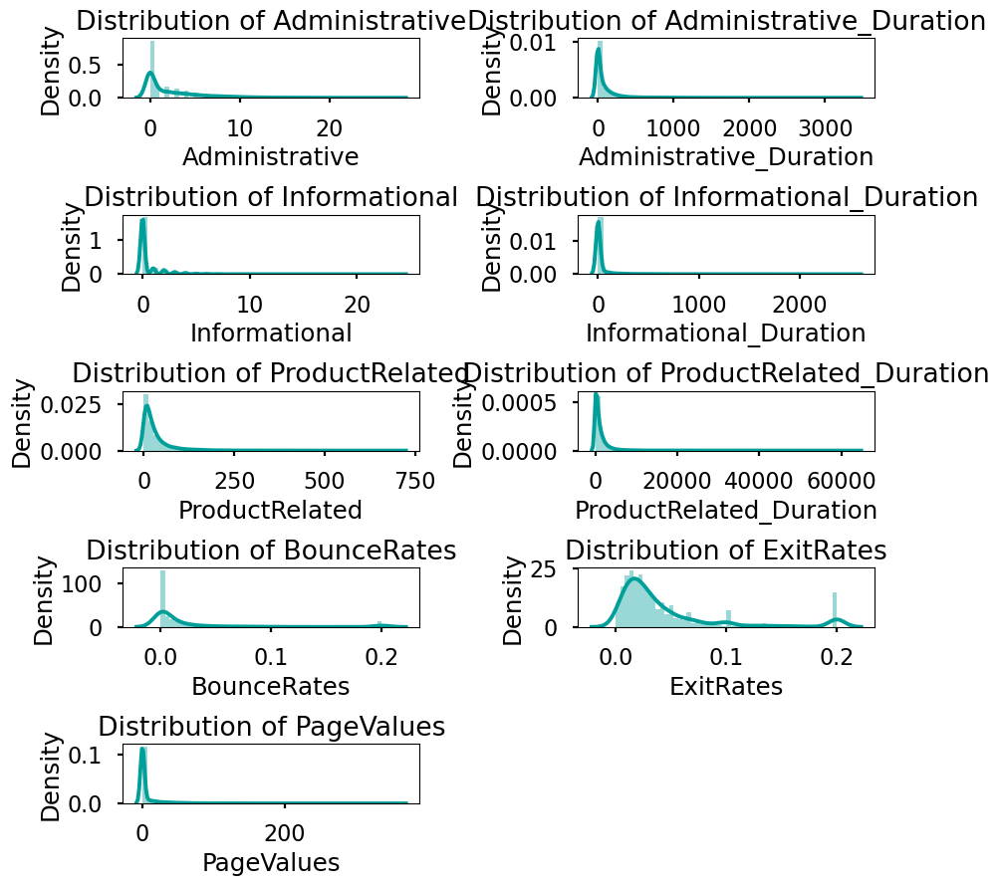

In [17]:
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(9, 9))
for i in range(0, len(num)):
    plt.subplot(5, 2, i+1)
    sns.distplot(x=df[num[i]], color='#009f99')
    plt.title('Distribution of {}'.format(num[i]))
    plt.xlabel(num[i])
    plt.tight_layout()

In [18]:
#skewness
for i in range(0, len(num)):
    print(f"Skewness {df[num].columns[i]}: {df[num[i]].skew()}")

Skewness Administrative: 1.9665169619932368
Skewness Administrative_Duration: 5.647260632909587
Skewness Informational: 4.070199525591103
Skewness Informational_Duration: 7.607771151653742
Skewness ProductRelated: 4.294880796697082
Skewness ProductRelated_Duration: 7.298838074592
Skewness BounceRates: 2.9357294071777877
Skewness ExitRates: 2.138716585762073
Skewness PageValues: 6.3210177279459465


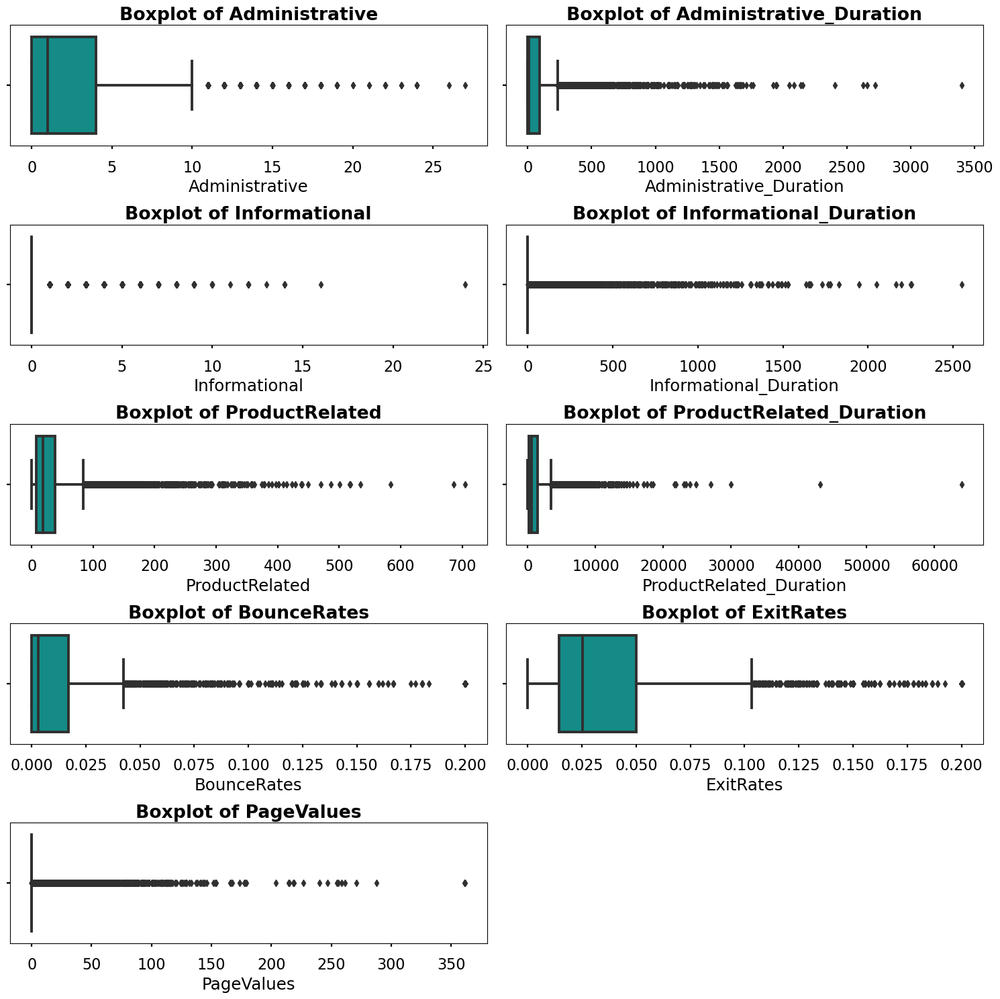

In [19]:
# boxplot
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(15,15))
for i in range(0, len(num)):
    plt.subplot(5, 2, i+1)
    sns.boxplot(x=df[num[i]], color='#009f99')
    plt.title('Boxplot of {}'.format(num[i]),fontweight='bold')
    plt.xlabel(num[i])
    plt.tight_layout()

Terdapat banyak outlier.

### Data Kategori

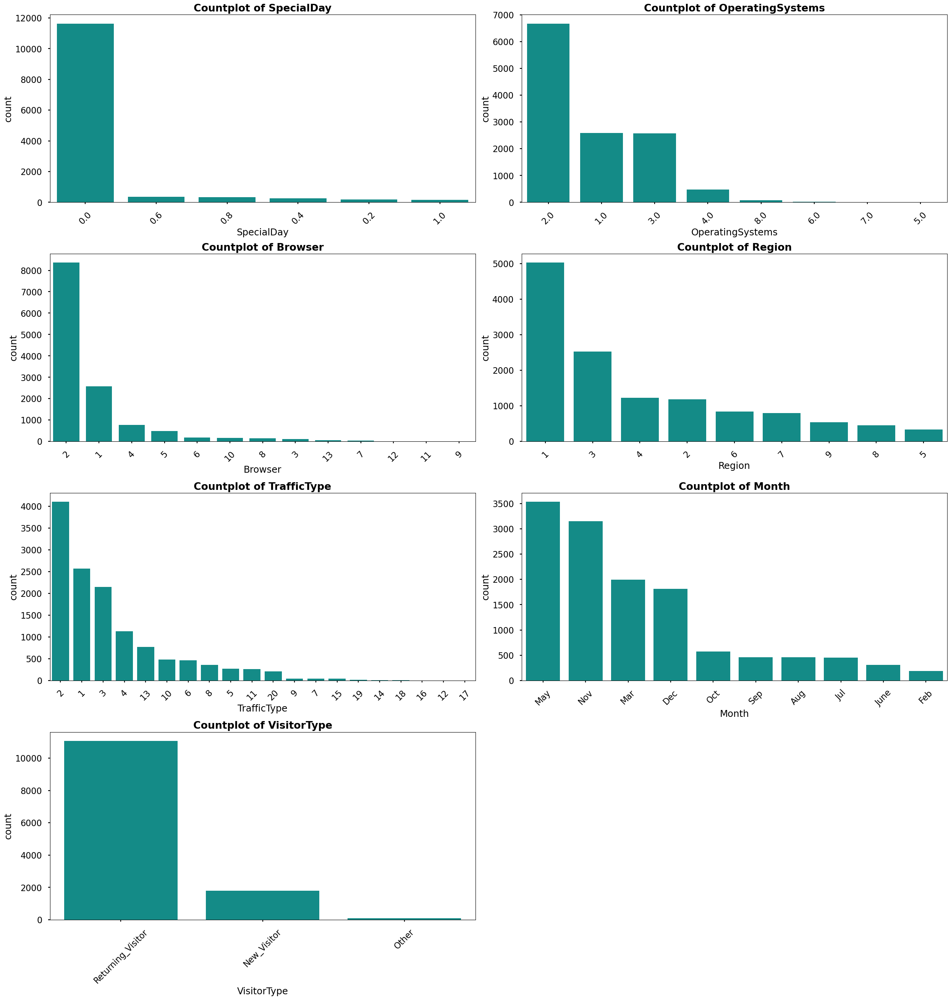

In [20]:
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(25, 25))
for i in range(0, len(cat)):
    plt.subplot(4, 2, i+1)
    sns.countplot(x=df[cat[i]], color='#009f99', order = df[cat[i]].value_counts().index)
    plt.title('Countplot of {}'.format(cat[i]),fontweight='bold')
    plt.xlabel(cat[i])
    plt.tight_layout()
    plt.xticks(rotation = 45)

`OperatingSystems` 

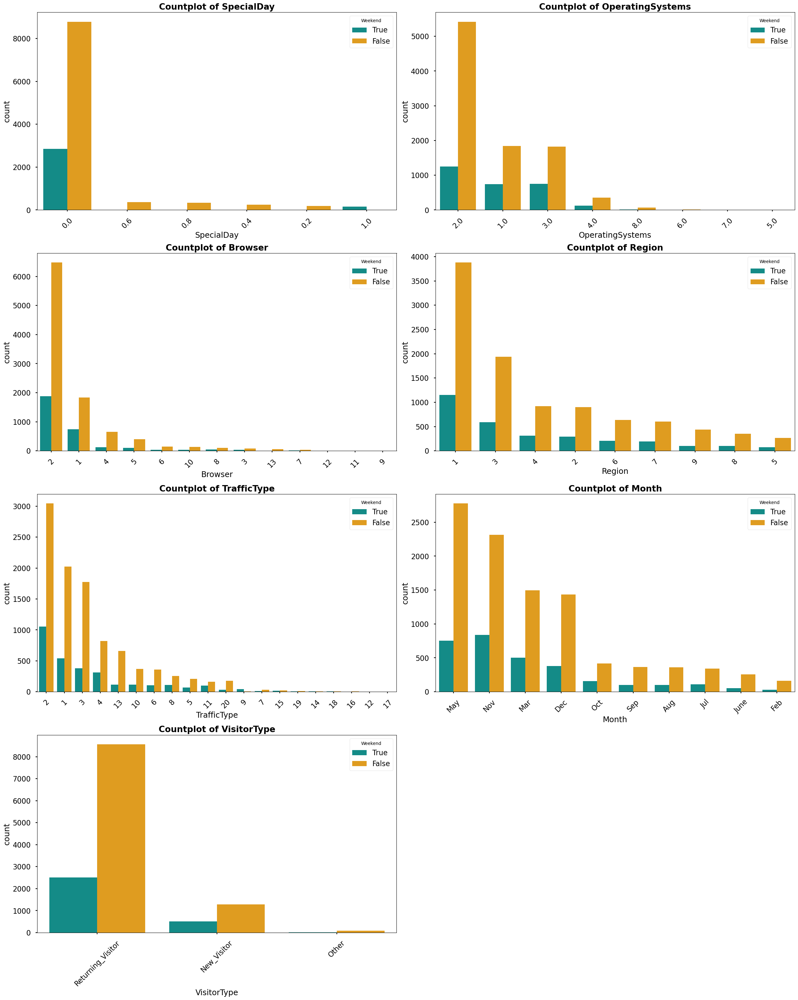

In [21]:
# Bar plot with hue
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(25, 30))
for i in range(0, len(cat)):
    plt.subplot(4, 2, i+1)
    sns.countplot(x=df[cat[i]], order = df[cat[i]].value_counts().index, hue=df['Weekend'], hue_order=[True, False],palette=["#009f99", "orange"])
    plt.title('Countplot of {}'.format(cat[i]),fontweight='bold')
    plt.xlabel(cat[i])
    plt.tight_layout()
    plt.xticks(rotation = 45)

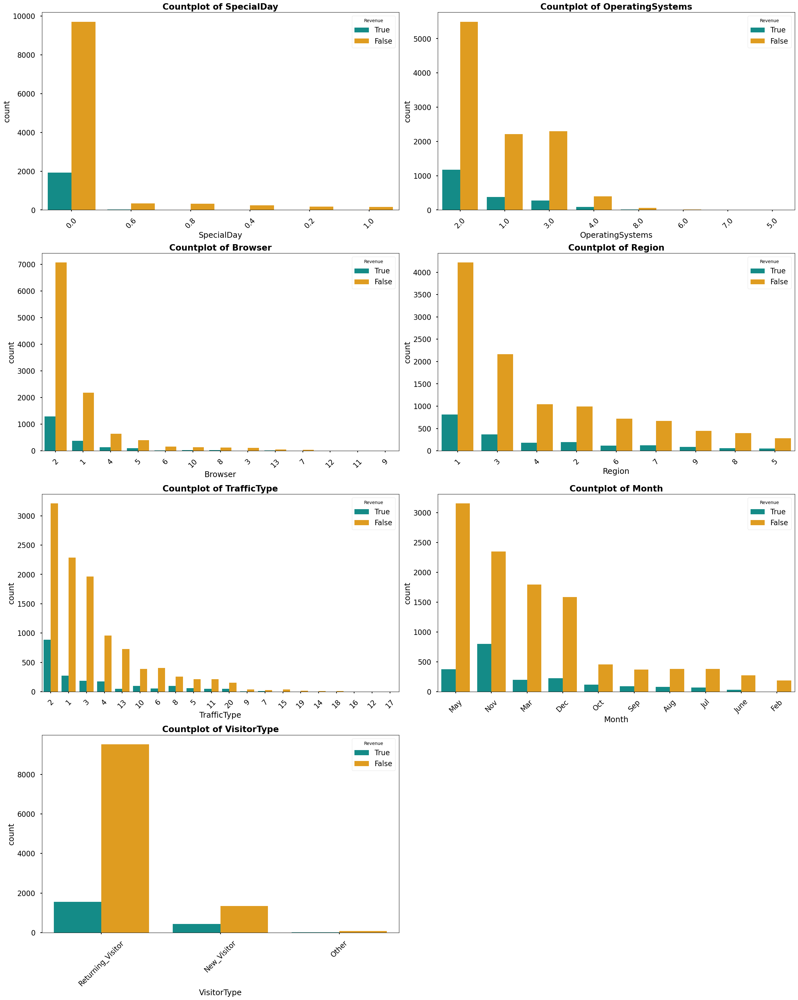

In [22]:
# Bar plot with hue
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(25, 30))
for i in range(0, len(cat)):
    plt.subplot(4, 2, i+1)
    sns.countplot(x=df[cat[i]], order = df[cat[i]].value_counts().index, hue=df['Revenue'], hue_order=[True, False],palette=["#009f99", "orange"])
    plt.title('Countplot of {}'.format(cat[i]),fontweight='bold')
    plt.xlabel(cat[i])
    plt.tight_layout()
    plt.xticks(rotation = 45)

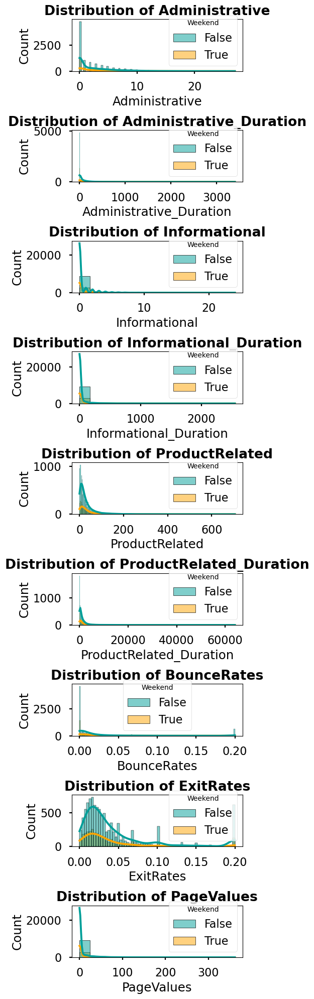

In [23]:
# histogram plot
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(5, 20))
for i in range(0, len(num)):
    plt.subplot(9, 1, i+1)
    sns.histplot(x=df[num[i]], kde = True, hue = df['Weekend'],palette=["#009f99", "orange"],alpha = 0.5)
    plt.title('Distribution of {}'.format(num[i]),fontweight='bold')
    plt.xlabel(num[i])
    plt.tight_layout()

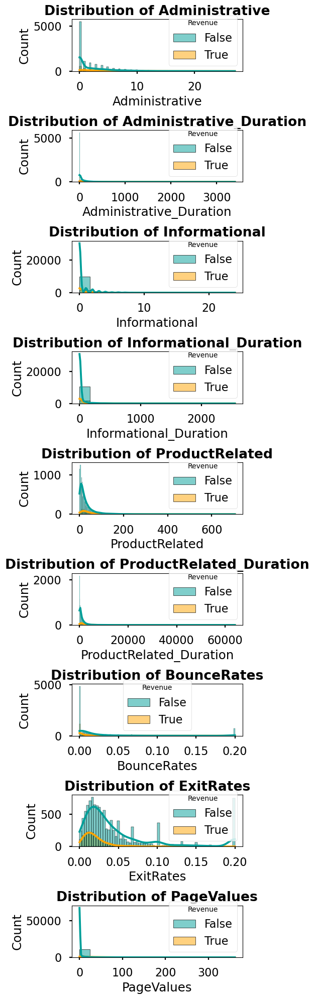

In [24]:
# histogram plot
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(5, 20))
for i in range(0, len(num)):
    plt.subplot(9, 1, i+1)
    sns.histplot(x=df[num[i]], kde = True, hue = df['Revenue'],palette=["#009f99", "orange"],alpha = 0.5)
    plt.title('Distribution of {}'.format(num[i]),fontweight='bold')
    plt.xlabel(num[i])
    plt.tight_layout()

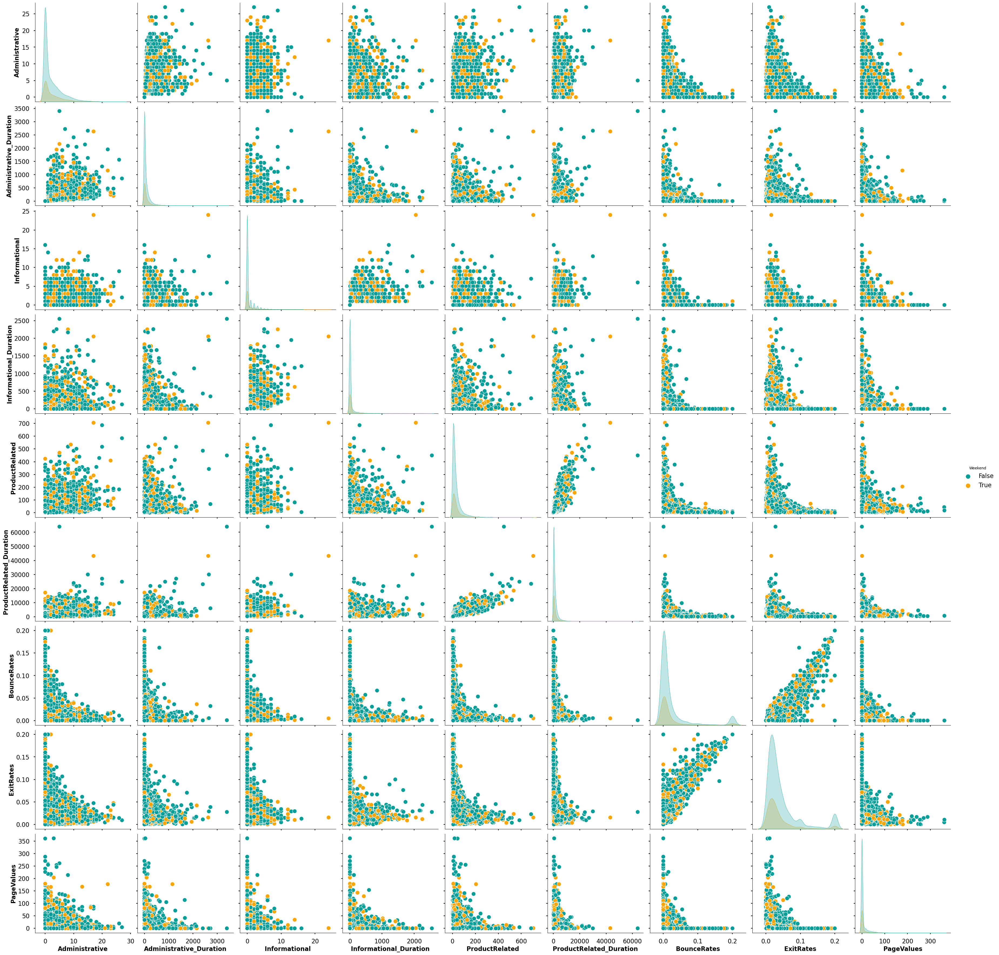

In [25]:
# pairplot
df_pairplot = df[['Administrative',
 'Administrative_Duration',
 'Informational',
 'Informational_Duration',
 'ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues',
'Weekend']]
style.use('seaborn-v0_8-poster')
pr = sns.pairplot(df_pairplot, diag_kind='kde',hue='Weekend', palette=["#009f99", "orange"], size=4)
for ax in pr.axes.flatten():
    ax.set_ylabel(ax.get_ylabel(),fontsize=16, fontweight='bold')
    ax.set_xlabel(ax.get_xlabel(),fontsize=16, fontweight='bold')

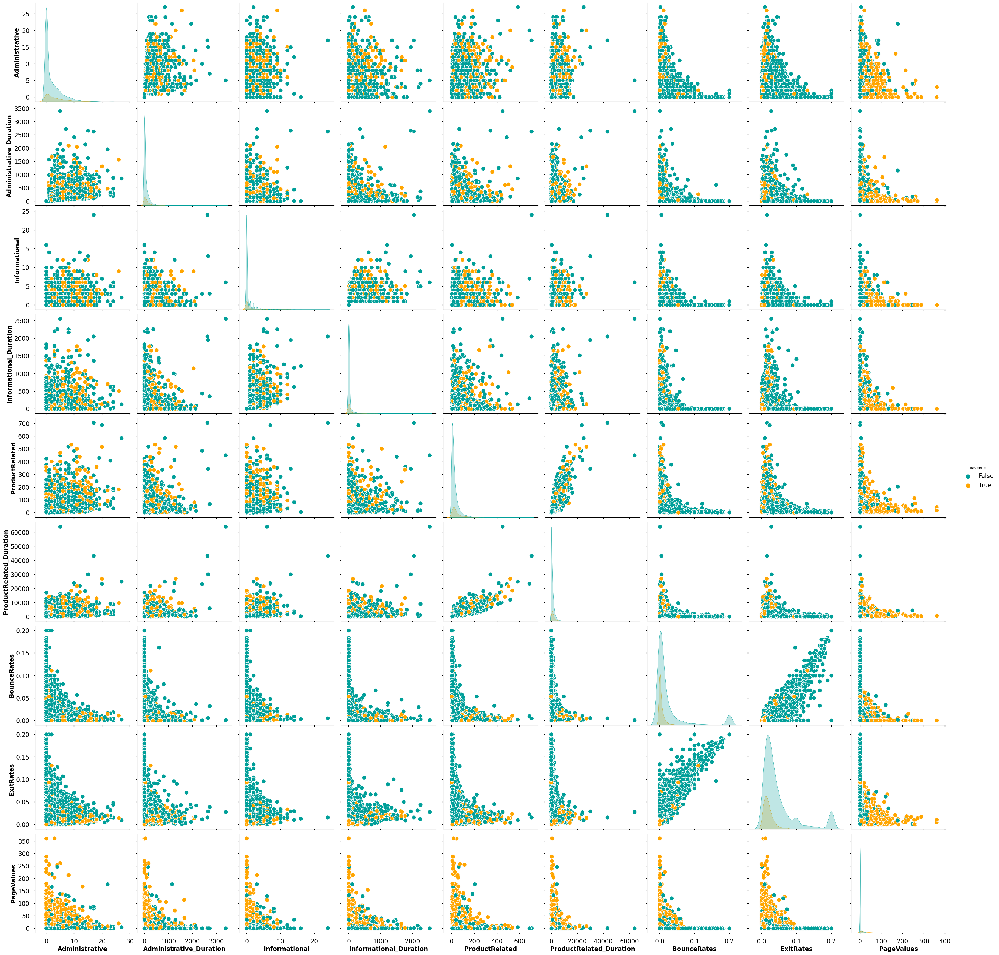

In [26]:
# pairplot
df_pairplot = df[['Administrative',
 'Administrative_Duration',
 'Informational',
 'Informational_Duration',
 'ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues',
'Revenue']]
style.use('seaborn-v0_8-poster')
pr = sns.pairplot(df_pairplot, diag_kind='kde',hue='Revenue', palette=["#009f99", "orange"], size=4)
for ax in pr.axes.flatten():
    ax.set_ylabel(ax.get_ylabel(),fontsize=16, fontweight='bold')
    ax.set_xlabel(ax.get_xlabel(),fontsize=16, fontweight='bold')

In [27]:
num

['Administrative',
 'Administrative_Duration',
 'Informational',
 'Informational_Duration',
 'ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues']

## Multivariate Analysis

In [28]:
df_heatmap = df[['Administrative',
 'Administrative_Duration',
 'Informational',
 'Informational_Duration',
 'ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues',
'Revenue']]

[Text(0.5, 0, 'Administrative'),
 Text(1.5, 0, 'Administrative_Duration'),
 Text(2.5, 0, 'Informational'),
 Text(3.5, 0, 'Informational_Duration'),
 Text(4.5, 0, 'ProductRelated'),
 Text(5.5, 0, 'ProductRelated_Duration'),
 Text(6.5, 0, 'BounceRates'),
 Text(7.5, 0, 'ExitRates'),
 Text(8.5, 0, 'PageValues'),
 Text(9.5, 0, 'Revenue')]

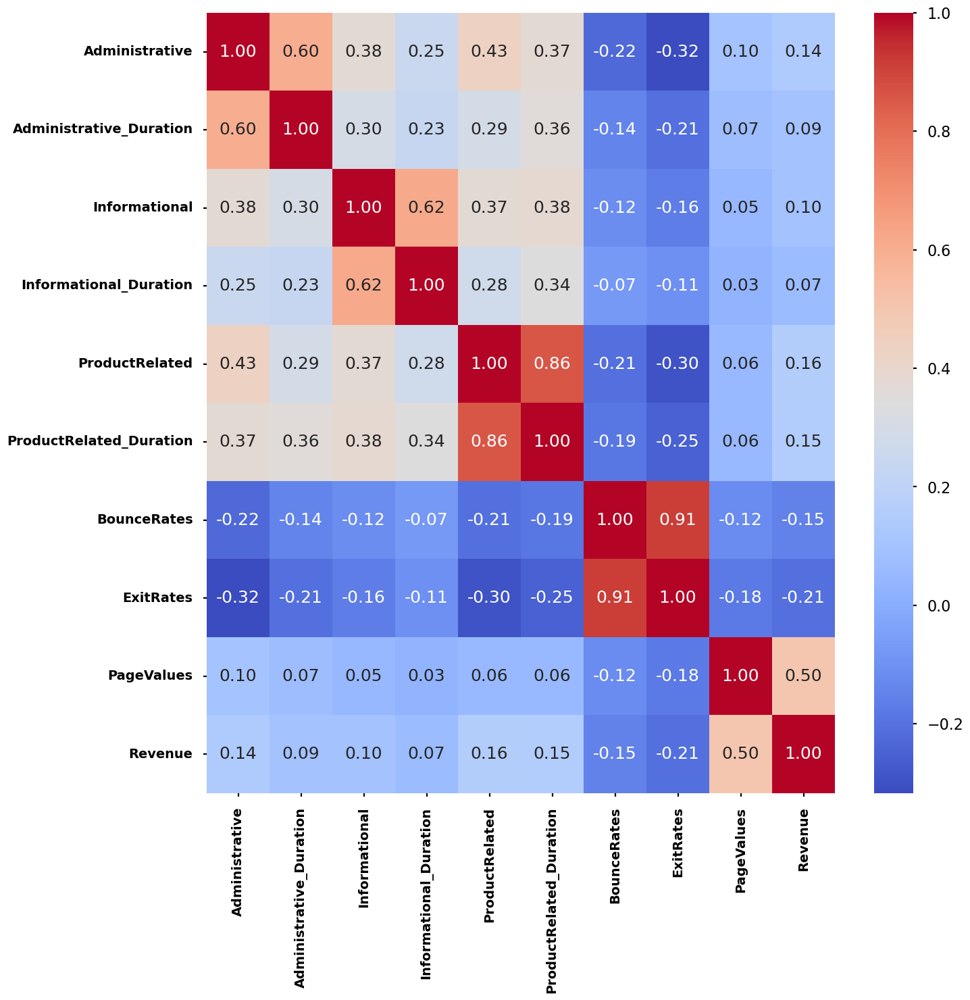

In [29]:
# heatmap
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(15, 15))
ax = sns.heatmap(df_heatmap.corr(), annot=True, cmap='coolwarm', fmt='.2f',annot_kws={'size': 18})
ax.set_yticklabels(ax.get_yticklabels(), fontsize=14, fontweight='bold')
ax.set_xticklabels(ax.get_xticklabels(), fontsize=14, fontweight='bold')

[Text(0.5, 0, 'Administrative'),
 Text(1.5, 0, 'Administrative_Duration'),
 Text(2.5, 0, 'Informational'),
 Text(3.5, 0, 'Informational_Duration'),
 Text(4.5, 0, 'ProductRelated'),
 Text(5.5, 0, 'ProductRelated_Duration'),
 Text(6.5, 0, 'BounceRates'),
 Text(7.5, 0, 'ExitRates'),
 Text(8.5, 0, 'PageValues'),
 Text(9.5, 0, 'SpecialDay'),
 Text(10.5, 0, 'OperatingSystems'),
 Text(11.5, 0, 'Browser'),
 Text(12.5, 0, 'Region'),
 Text(13.5, 0, 'TrafficType'),
 Text(14.5, 0, 'Weekend'),
 Text(15.5, 0, 'Revenue')]

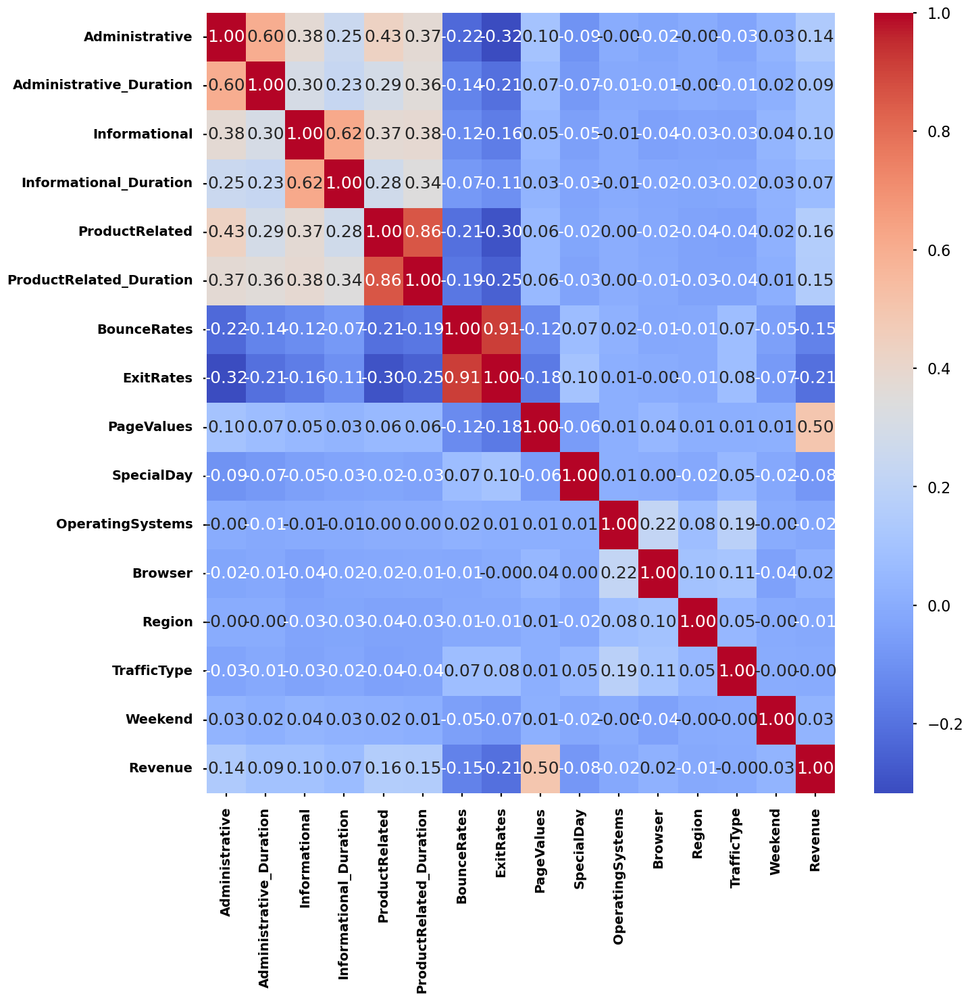

In [30]:
# heatmap
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(15, 15))
ax = sns.heatmap(df.corr(), annot=True, cmap='coolwarm', fmt='.2f',annot_kws={'size': 18})
ax.set_yticklabels(ax.get_yticklabels(), fontsize=14, fontweight='bold')
ax.set_xticklabels(ax.get_xticklabels(), fontsize=14, fontweight='bold')

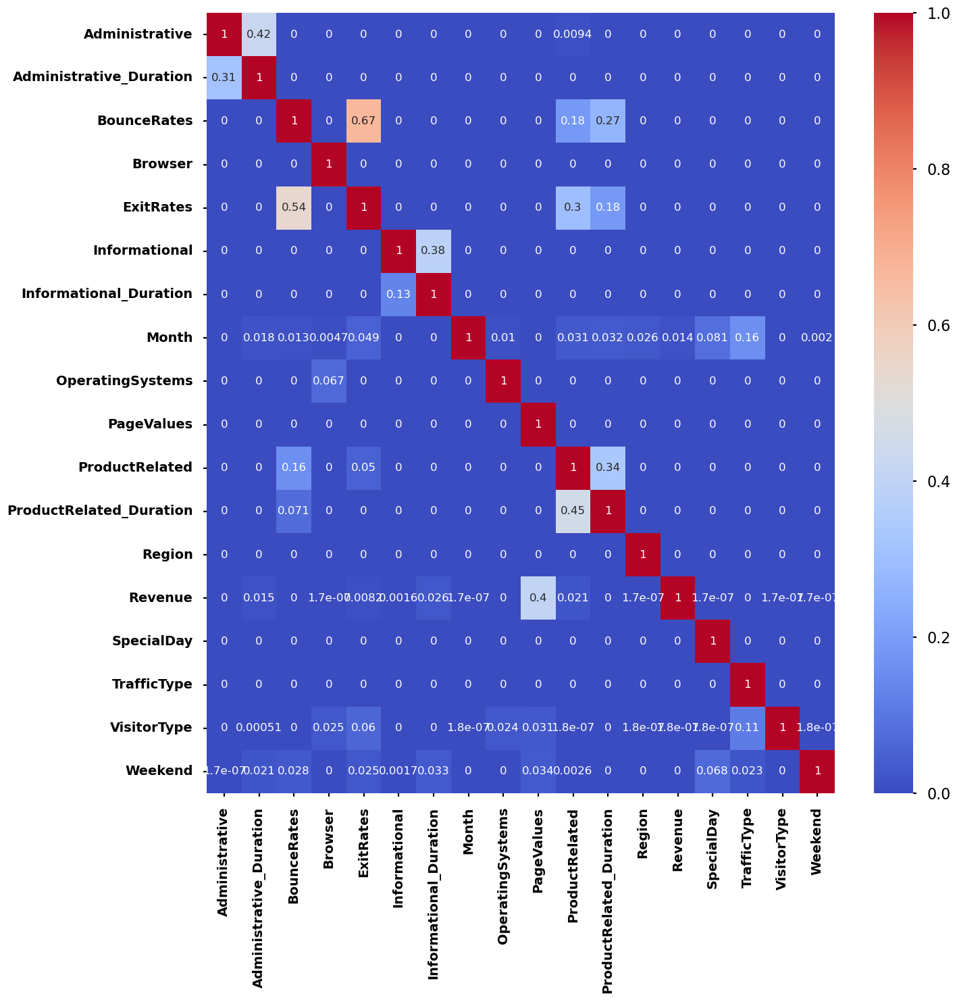

In [31]:
# PPS (Predictive Power Score)
df_pps = pps.matrix(df)
matrix_df = df_pps[['x', 'y', 'ppscore']].pivot(columns='x', index='y', values='ppscore')
plt.figure(figsize=(15, 15))
ax = sns.heatmap(matrix_df, vmin=0, vmax=1, cmap='coolwarm', annot=True, annot_kws={'size': 12})
ax.set_yticklabels(ax.get_yticklabels(), fontsize=14, fontweight='bold')
ax.set_xticklabels(ax.get_xticklabels(), fontsize=14, fontweight='bold')
plt.xlabel(None)
plt.ylabel(None)
plt.show()

## Data Preprocessing

In [32]:
df.duplicated().any()

True

In [33]:
df.duplicated().any()

True

In [34]:
df.isnull().sum()

Administrative             111
Administrative_Duration    633
Informational                0
Informational_Duration       0
ProductRelated               0
ProductRelated_Duration    639
BounceRates                 74
ExitRates                    0
PageValues                   0
SpecialDay                   0
Month                        0
OperatingSystems           524
Browser                      0
Region                       0
TrafficType                  0
VisitorType                  0
Weekend                      0
Revenue                      0
dtype: int64

karena semua data yang memiliki *missing values* berdistribusi *positively skewed*, data tersebut akan diisi dengan median.

In [35]:
df_pre = df.copy()

In [36]:
df_pre.drop_duplicates(subset=None, keep='first', inplace=False, ignore_index=False)

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0.0,0.0,0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,Feb,1.0,1,1,1,Returning_Visitor,False,False
1,0.0,0.0,0,0.0,2,64.000000,0.000000,0.100000,0.000000,0.0,Feb,2.0,2,1,2,Returning_Visitor,False,False
2,0.0,0.0,0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,Feb,4.0,1,9,3,Returning_Visitor,False,False
3,0.0,NaN,0,0.0,2,2.666667,0.050000,0.140000,0.000000,0.0,Feb,3.0,2,2,4,Returning_Visitor,False,False
4,0.0,0.0,0,0.0,10,627.500000,0.020000,0.050000,0.000000,0.0,Feb,3.0,3,1,4,Returning_Visitor,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12325,3.0,145.0,0,0.0,53,1783.791667,0.007143,0.029031,12.241717,0.0,Dec,4.0,6,1,1,Returning_Visitor,True,False
12326,0.0,0.0,0,0.0,5,465.750000,0.000000,0.021333,0.000000,0.0,Nov,3.0,2,1,8,Returning_Visitor,True,False
12327,0.0,NaN,0,0.0,6,184.250000,0.083333,0.086667,0.000000,0.0,Nov,3.0,2,1,13,Returning_Visitor,True,False
12328,4.0,75.0,0,0.0,15,346.000000,0.000000,0.021053,0.000000,0.0,Nov,2.0,2,3,11,Returning_Visitor,False,False


In [37]:
df_pre['Administrative'].fillna(df_pre['Administrative'].median(), inplace=True)
df_pre['Administrative_Duration'].fillna(df_pre['Administrative_Duration'].median(), inplace=True)
df_pre['ProductRelated_Duration'].fillna(df_pre['ProductRelated_Duration'].median(), inplace=True)
df_pre['BounceRates'].fillna(df_pre['BounceRates'].median(), inplace=True)
df_pre['OperatingSystems'].fillna(df_pre['OperatingSystems'].median(), inplace=True)

In [38]:
df_pre.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12946 entries, 0 to 12945
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           12946 non-null  float64
 1   Administrative_Duration  12946 non-null  float64
 2   Informational            12946 non-null  int64  
 3   Informational_Duration   12946 non-null  float64
 4   ProductRelated           12946 non-null  int64  
 5   ProductRelated_Duration  12946 non-null  float64
 6   BounceRates              12946 non-null  float64
 7   ExitRates                12946 non-null  float64
 8   PageValues               12946 non-null  float64
 9   SpecialDay               12946 non-null  float64
 10  Month                    12946 non-null  object 
 11  OperatingSystems         12946 non-null  float64
 12  Browser                  12946 non-null  int64  
 13  Region                   12946 non-null  int64  
 14  TrafficType           

## Handling Outliers

In [39]:
df_iqr = df_pre.copy()
outliers_cols_list = ['Administrative',
 'Administrative_Duration',
 'Informational',
 'Informational_Duration',
 'ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues']

print(f'Jumlah baris sebelum memfilter outlier: {len(df_iqr)}')
filtered_entries = np.array([True] * len(df_iqr))

for col in outliers_cols_list:
    Q1 = df_iqr[col].quantile(0.25)
    Q3 = df_iqr[col].quantile(0.75)
    IQR = Q3 - Q1
    low_limit = Q1 - (IQR * 1.5)
    high_limit = Q3 + (IQR * 1.5)

    filtered_entries = ((df_iqr[col] >= low_limit) & (df_iqr[col] <= high_limit)) & filtered_entries
    
df_iqr = df_iqr[filtered_entries]
print(f'Jumlah baris setelah memfilter outlier: {len(df_iqr)}')
print(f'Jumlah data yang difilter: {round((len(df_pre)-len(df_iqr))/len(df_pre)*100, 2)}%')

Jumlah baris sebelum memfilter outlier: 12946
Jumlah baris setelah memfilter outlier: 6123
Jumlah data yang difilter: 52.7%


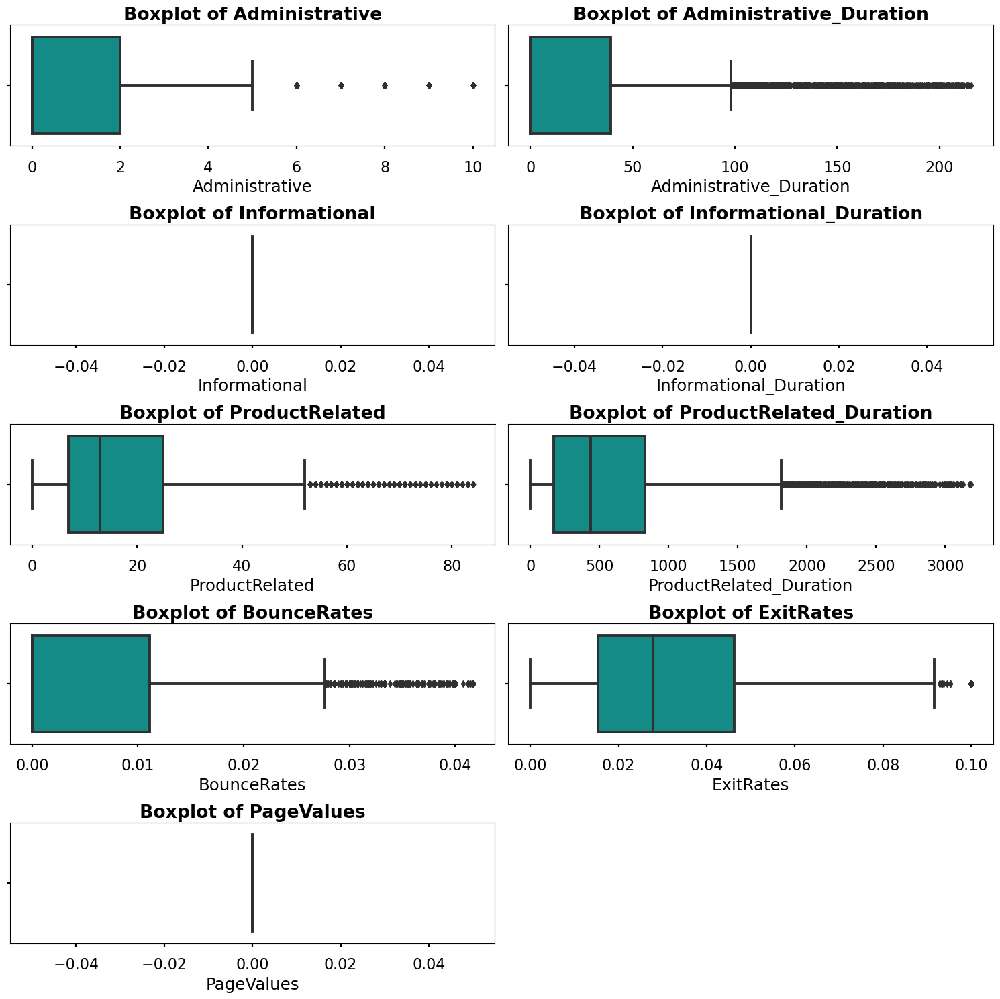

In [40]:
# boxplot
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(15,15))
for i in range(0, len(num)):
    plt.subplot(5, 2, i+1)
    sns.boxplot(x=df_iqr[num[i]], color='#009f99')
    plt.title('Boxplot of {}'.format(num[i]),fontweight='bold')
    plt.xlabel(num[i])
    plt.tight_layout()

In [41]:
df_out_iqr = df_pre.copy()
def outlier_handler(df_out_iqr, col):

    """
    Utility function to clean outlier using Tukey Fences Method.
    :param df: Dataframe with outlier (pd.DataFrame)
    :param col: Numerical Feature (String)
    :return: Dataframe without outlier (pd.DataFrame)
    """

    q1 = df_out_iqr[col].quantile(0.25)
    q3 = df_out_iqr[col].quantile(0.75)
    iqr = q3-q1

    up_bound = q3 + 1.5*iqr
    low_bound = q1 - 1.5*iqr

    outlier = df_out_iqr[col][(df_out_iqr[col] < low_bound) | (df_out_iqr[col] > up_bound)]

    print(f'Percentage of outliers: {len(outlier)*100/len(df[col]):.2f}%')

    no_outlier = df_out_iqr[(df_out_iqr[col] >= low_bound) & (df_out_iqr[col] <= up_bound)]

    return no_outlier

In [42]:
df_out_iqr.columns

Index(['Administrative', 'Administrative_Duration', 'Informational',
       'Informational_Duration', 'ProductRelated', 'ProductRelated_Duration',
       'BounceRates', 'ExitRates', 'PageValues', 'SpecialDay', 'Month',
       'OperatingSystems', 'Browser', 'Region', 'TrafficType', 'VisitorType',
       'Weekend', 'Revenue'],
      dtype='object')

In [43]:
df_clean = df_out_iqr.drop(['SpecialDay',
 'OperatingSystems',
 'Browser',
 'Region',
 'TrafficType',
       'Month',
  'VisitorType', 'Weekend', 'Revenue'], axis=1)

In [44]:
df_clean.columns

Index(['Administrative', 'Administrative_Duration', 'Informational',
       'Informational_Duration', 'ProductRelated', 'ProductRelated_Duration',
       'BounceRates', 'ExitRates', 'PageValues'],
      dtype='object')

In [45]:
df_clean = outlier_handler(df_clean, 'Administrative')

Percentage of outliers: 3.21%


In [46]:
df_clean = outlier_handler(df_clean, 'Administrative_Duration')

Percentage of outliers: 9.16%


In [47]:
df_clean = outlier_handler(df_clean, 'Informational')

Percentage of outliers: 15.13%


In [48]:
df_clean = outlier_handler(df_clean, 'Informational_Duration')

Percentage of outliers: 0.00%


In [49]:
df_clean = outlier_handler(df_clean, 'ProductRelated')

Percentage of outliers: 5.05%


In [50]:
df_clean = outlier_handler(df_clean, 'ProductRelated_Duration')

Percentage of outliers: 4.17%


In [51]:
df_clean = outlier_handler(df_clean, 'BounceRates')

Percentage of outliers: 8.33%


In [52]:
df_clean = outlier_handler(df_clean, 'ExitRates')

Percentage of outliers: 1.15%


In [53]:
df_clean = outlier_handler(df_clean, 'PageValues')

Percentage of outliers: 8.23%


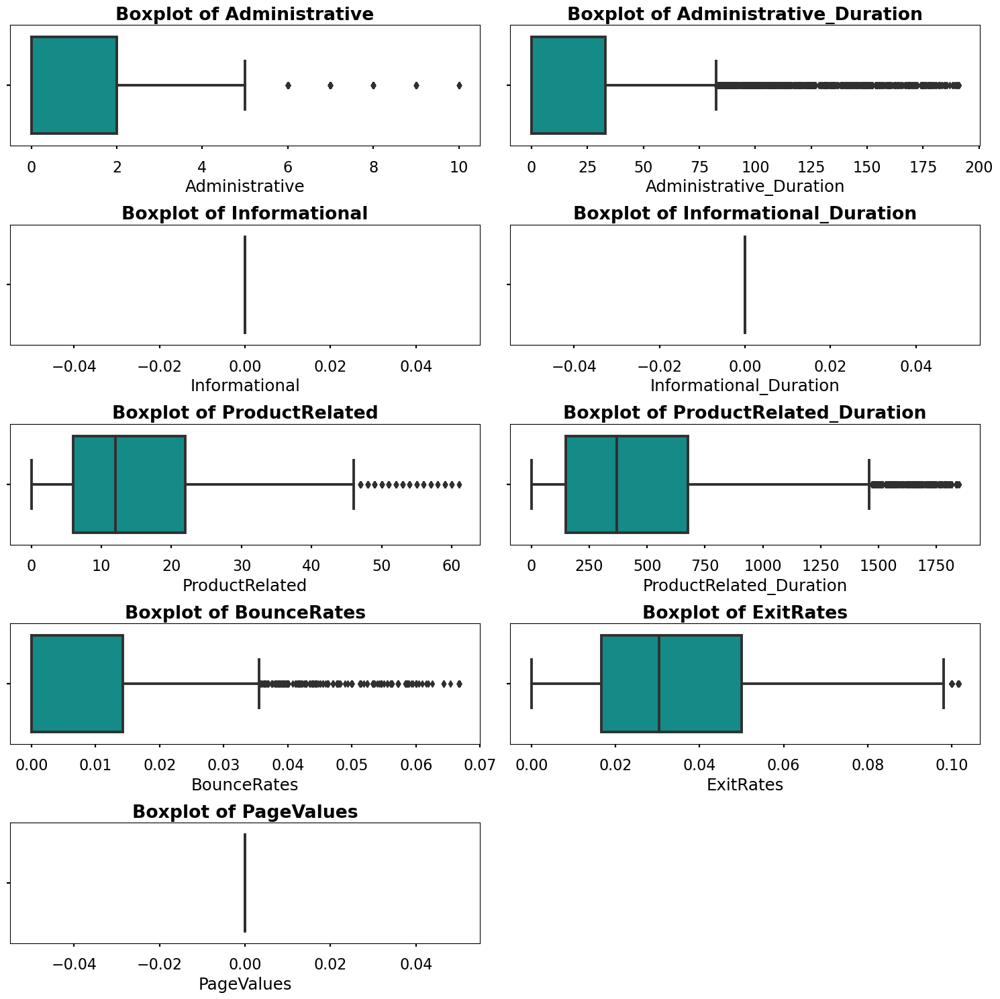

In [54]:
# boxplot
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(15,15))
for i in range(0, len(num)):
    plt.subplot(5, 2, i+1)
    sns.boxplot(x=df_clean[num[i]], color='#009f99')
    plt.title('Boxplot of {}'.format(num[i]),fontweight='bold')
    plt.xlabel(num[i])
    plt.tight_layout()

In [55]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12946 entries, 0 to 12945
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           12835 non-null  float64
 1   Administrative_Duration  12313 non-null  float64
 2   Informational            12946 non-null  int64  
 3   Informational_Duration   12946 non-null  float64
 4   ProductRelated           12946 non-null  int64  
 5   ProductRelated_Duration  12307 non-null  float64
 6   BounceRates              12872 non-null  float64
 7   ExitRates                12946 non-null  float64
 8   PageValues               12946 non-null  float64
 9   SpecialDay               12946 non-null  float64
 10  Month                    12946 non-null  object 
 11  OperatingSystems         12422 non-null  float64
 12  Browser                  12946 non-null  int64  
 13  Region                   12946 non-null  int64  
 14  TrafficType           

In [56]:
from scipy import stats
df_zscore = df_pre.copy()
outliers_cols_list = ['Administrative', 'Administrative_Duration', 'Informational',
       'Informational_Duration', 'ProductRelated', 'ProductRelated_Duration',
       'BounceRates', 'ExitRates', 'PageValues']

print(f'Jumlah baris sebelum memfilter outlier: {len(df_zscore)}')

filtered_entries = np.array([True] * len(df_zscore))

for col in outliers_cols_list:
    zscore = abs(stats.zscore(df_zscore[col])) # hitung absolute z-scorenya
    filtered_entries = (zscore < 3) & filtered_entries # keep yang kurang dari 3 absolute z-scorenya
    
df_zscore = df_zscore[filtered_entries].reset_index().drop(columns=['index']) # filter, cuma ambil yang z-scorenya di bawah 3

print(f'Jumlah baris setelah memfilter outlier: {len(df_zscore)}')
print(f'Jumlah data yang difilter: {round((len(df_pre)-len(df_zscore))/len(df_pre)*100, 2)}%')

Jumlah baris sebelum memfilter outlier: 12946
Jumlah baris setelah memfilter outlier: 10976
Jumlah data yang difilter: 15.22%


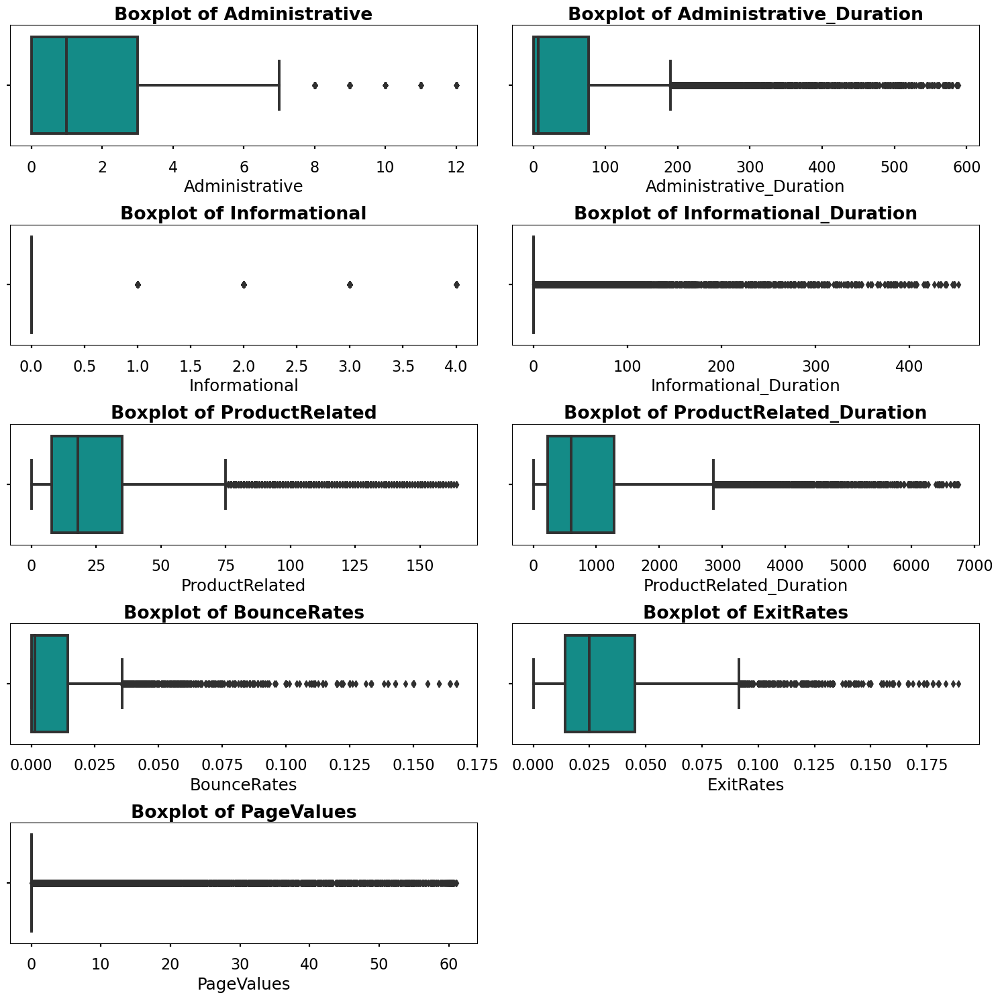

In [57]:
style.use('seaborn-v0_8-poster')
plt.figure(figsize=(15,15))
for i in range(0, len(num)):
    plt.subplot(5, 2, i+1)
    sns.boxplot(x=df_zscore[num[i]], color='#009f99')
    plt.title('Boxplot of {}'.format(num[i]),fontweight='bold')
    plt.xlabel(num[i])
    plt.tight_layout()

## Business Insight

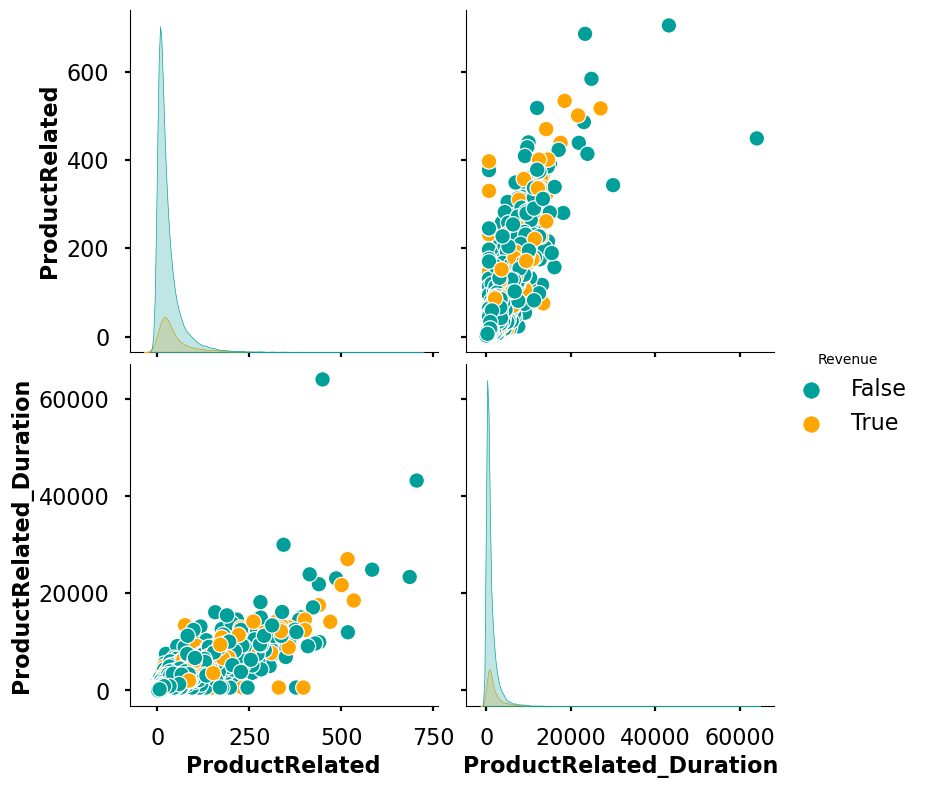

In [58]:
# pairplot
df_pairplot = df_pre[['ProductRelated', 'ProductRelated_Duration', 'Revenue']]
style.use('seaborn-v0_8-poster')
pr = sns.pairplot(df_pairplot, diag_kind='kde',hue='Revenue', palette=["#009f99", "orange"], size=4)
for ax in pr.axes.flatten():
    ax.set_ylabel(ax.get_ylabel(),fontsize=16, fontweight='bold')
    ax.set_xlabel(ax.get_xlabel(),fontsize=16, fontweight='bold')

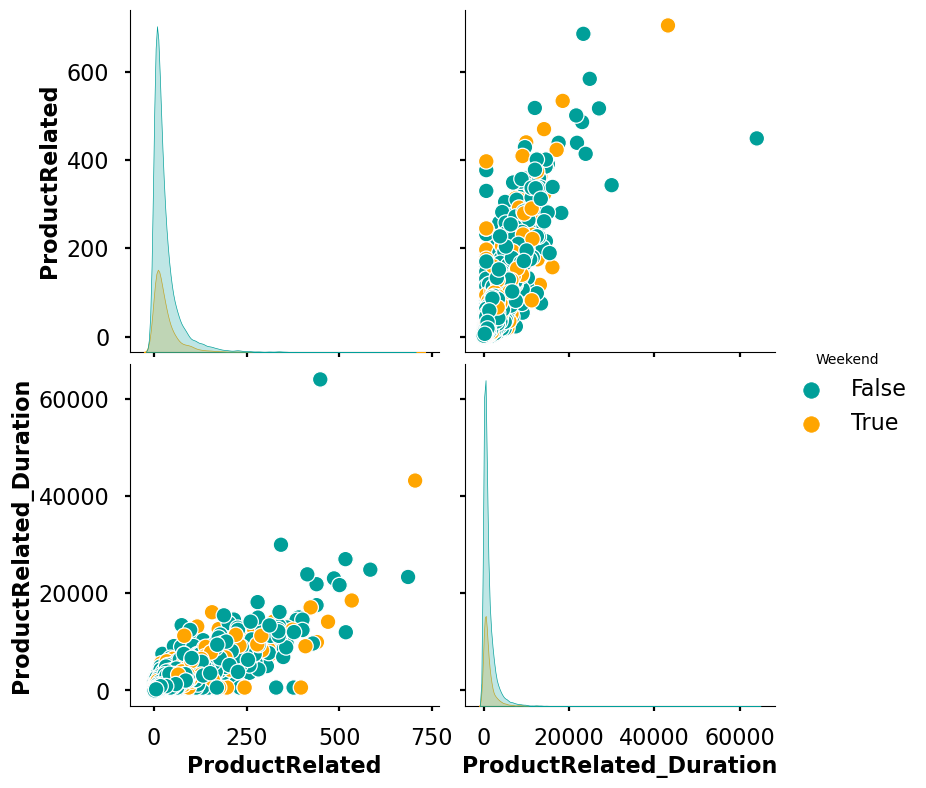

In [59]:
# pairplot
df_pairplot = df_pre[['ProductRelated', 'ProductRelated_Duration', 'Weekend']]
style.use('seaborn-v0_8-poster')
pr = sns.pairplot(df_pairplot, diag_kind='kde',hue='Weekend', palette=["#009f99", "orange"], size=4)
for ax in pr.axes.flatten():
    ax.set_ylabel(ax.get_ylabel(),fontsize=16, fontweight='bold')
    ax.set_xlabel(ax.get_xlabel(),fontsize=16, fontweight='bold')

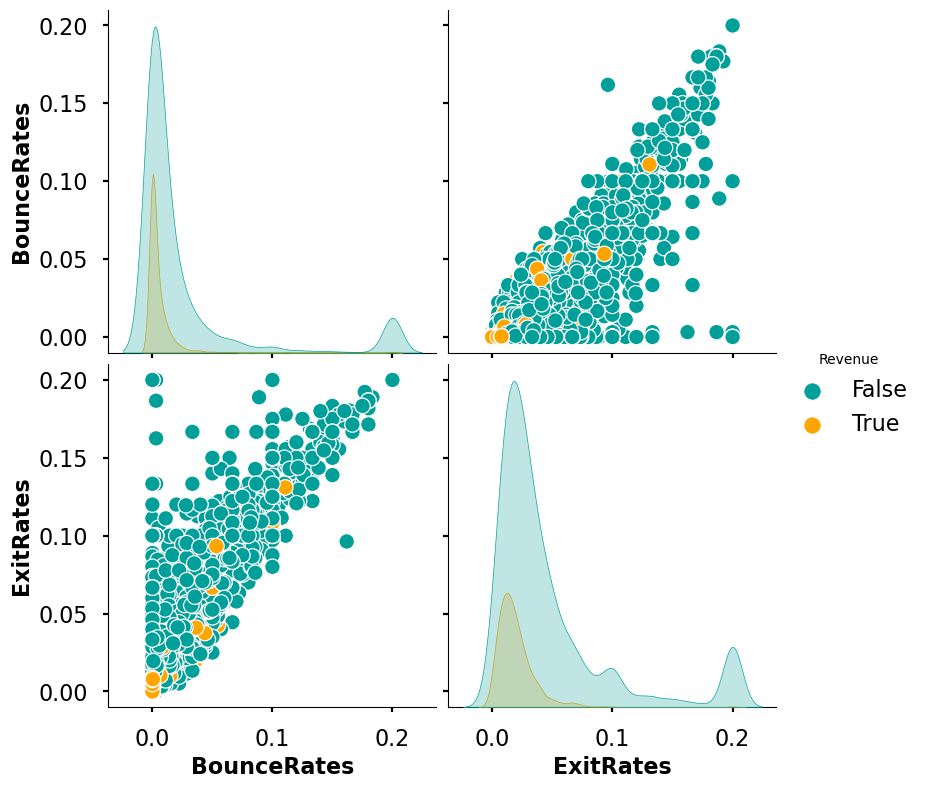

In [60]:
# pairplot
df_pairplot = df_pre[['BounceRates', 'ExitRates', 'Revenue']]
style.use('seaborn-v0_8-poster')
pr = sns.pairplot(df_pairplot, diag_kind='kde',hue='Revenue', palette=["#009f99", "orange"], size=4)
for ax in pr.axes.flatten():
    ax.set_ylabel(ax.get_ylabel(),fontsize=16, fontweight='bold')
    ax.set_xlabel(ax.get_xlabel(),fontsize=16, fontweight='bold')

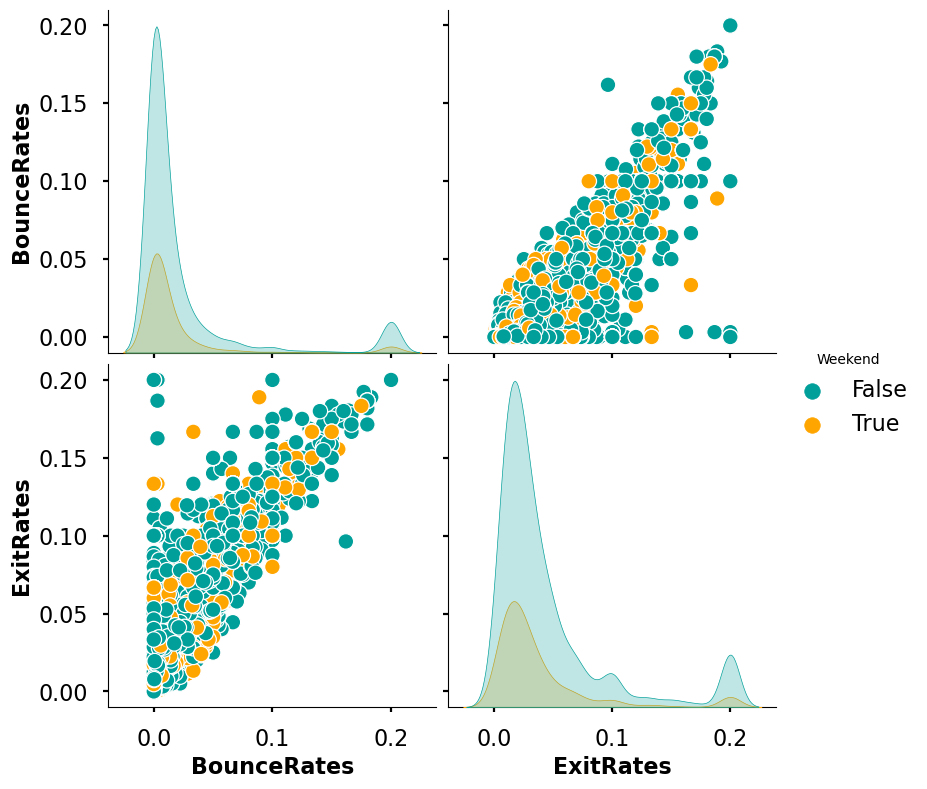

In [61]:
# pairplot
df_pairplot = df_pre[['BounceRates', 'ExitRates', 'Weekend']]
style.use('seaborn-v0_8-poster')
pr = sns.pairplot(df_pairplot, diag_kind='kde',hue='Weekend', palette=["#009f99", "orange"], size=4)
for ax in pr.axes.flatten():
    ax.set_ylabel(ax.get_ylabel(),fontsize=16, fontweight='bold')
    ax.set_xlabel(ax.get_xlabel(),fontsize=16, fontweight='bold')

<Axes: xlabel='ProductRelated', ylabel='ProductRelated_Duration'>

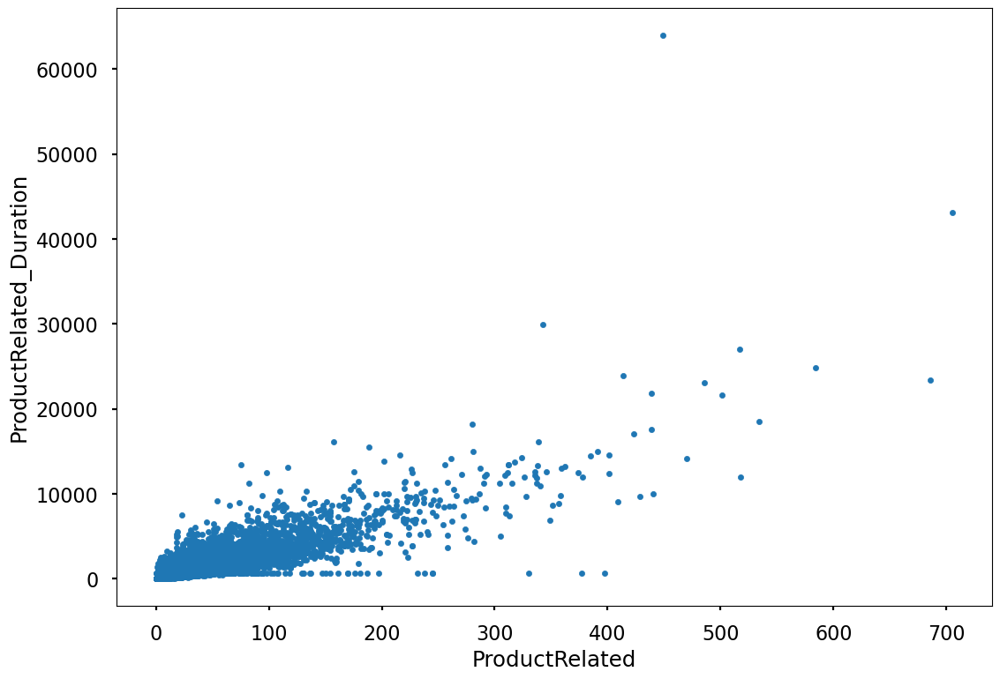

In [62]:
df_pre.plot.scatter(x = 'ProductRelated', y= 'ProductRelated_Duration')

<Axes: xlabel='BounceRates', ylabel='ExitRates'>

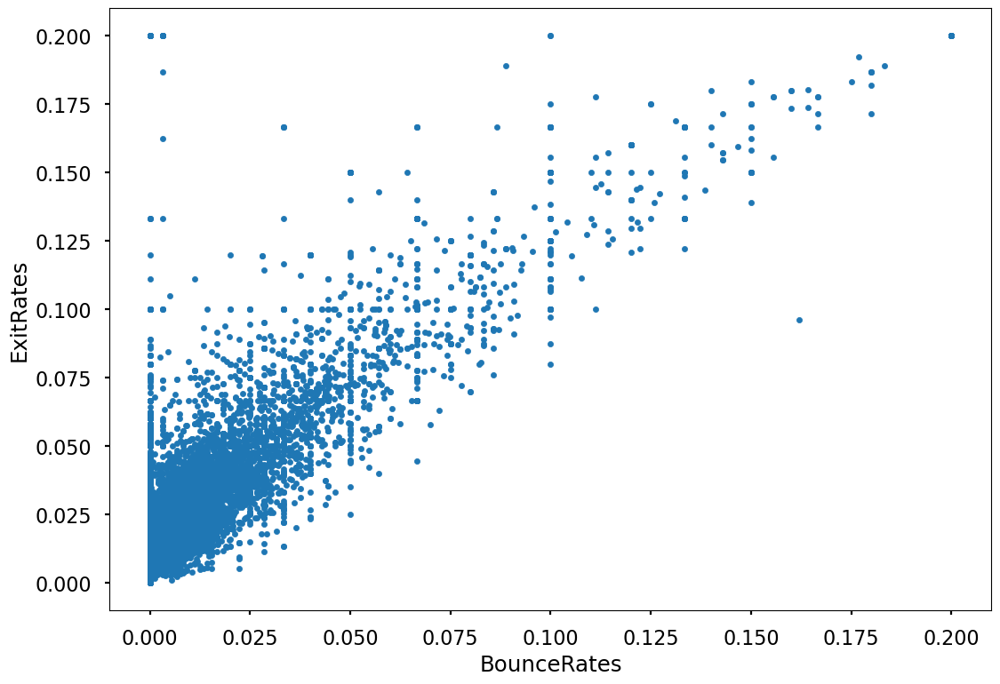

In [63]:
df_pre.plot.scatter(x = 'BounceRates', y = 'ExitRates')

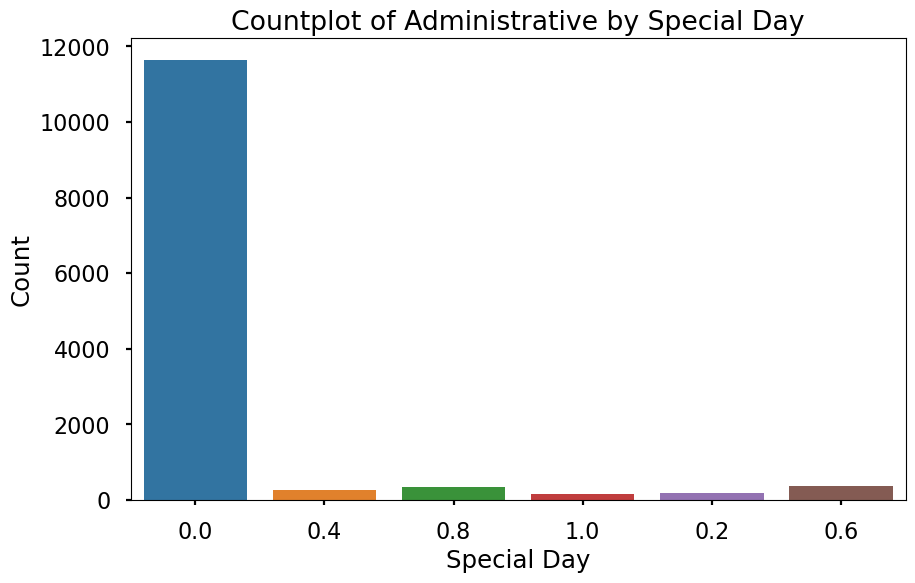

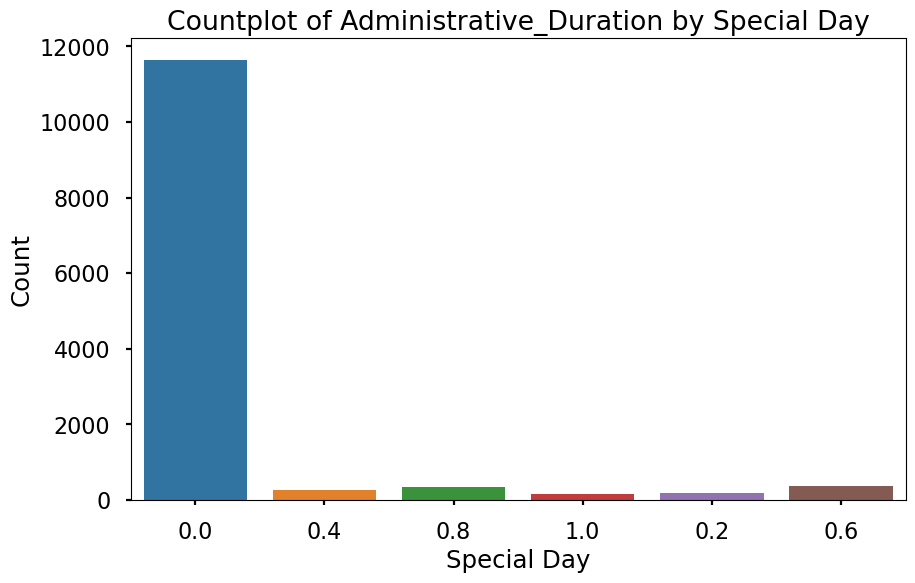

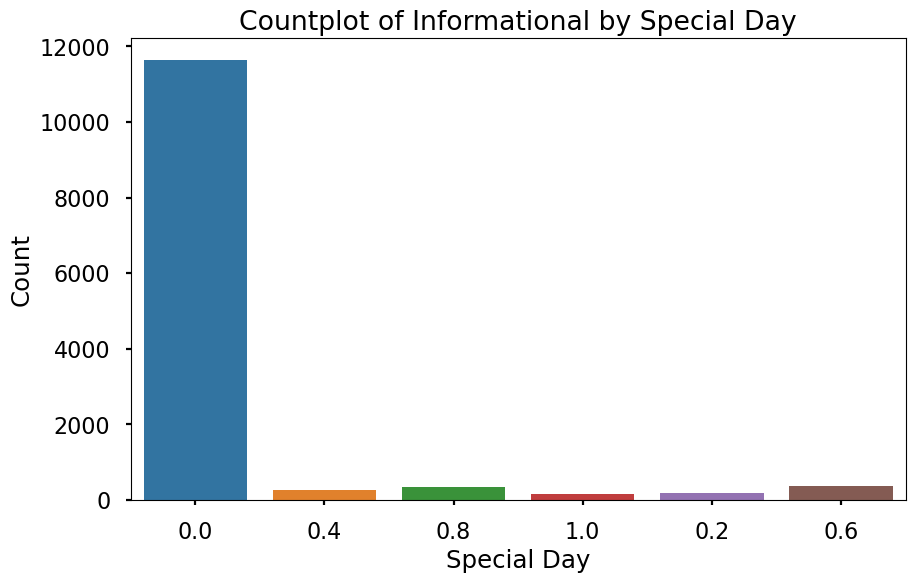

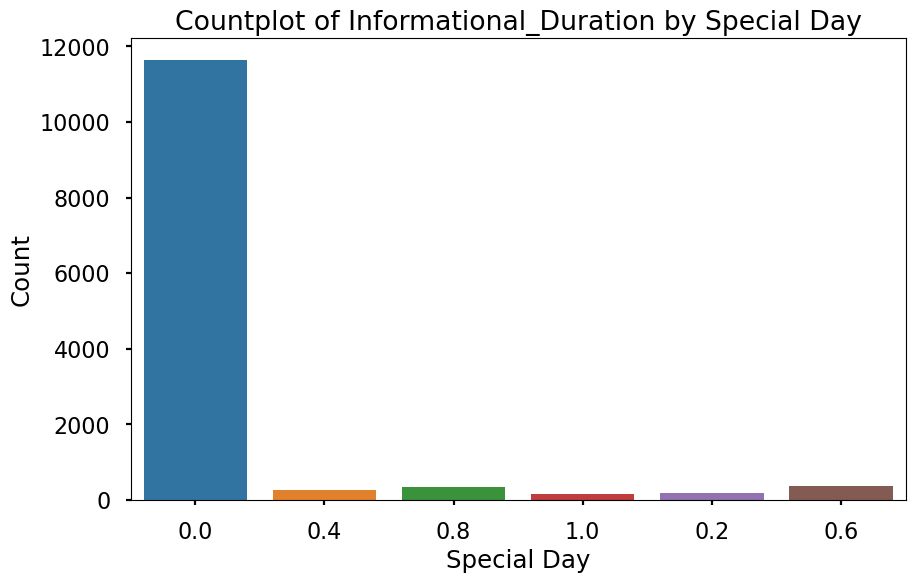

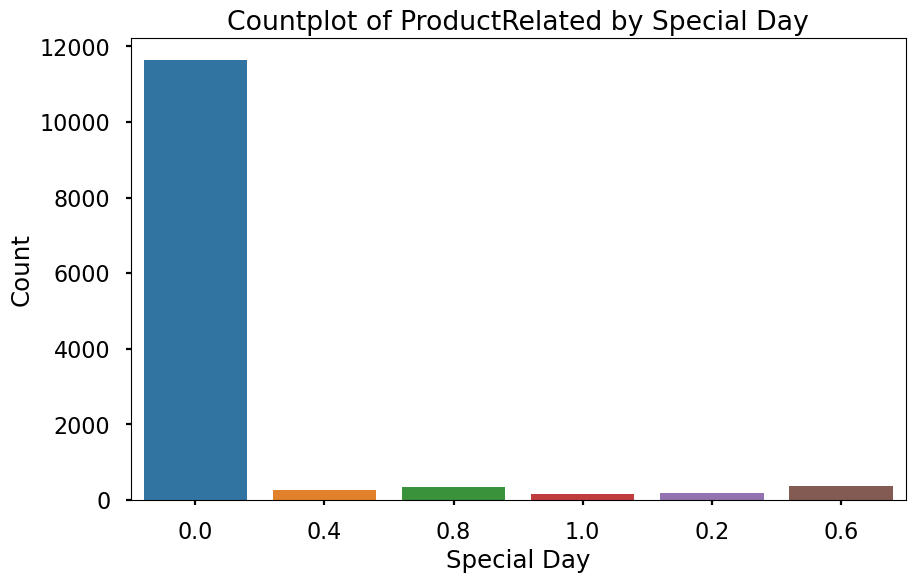

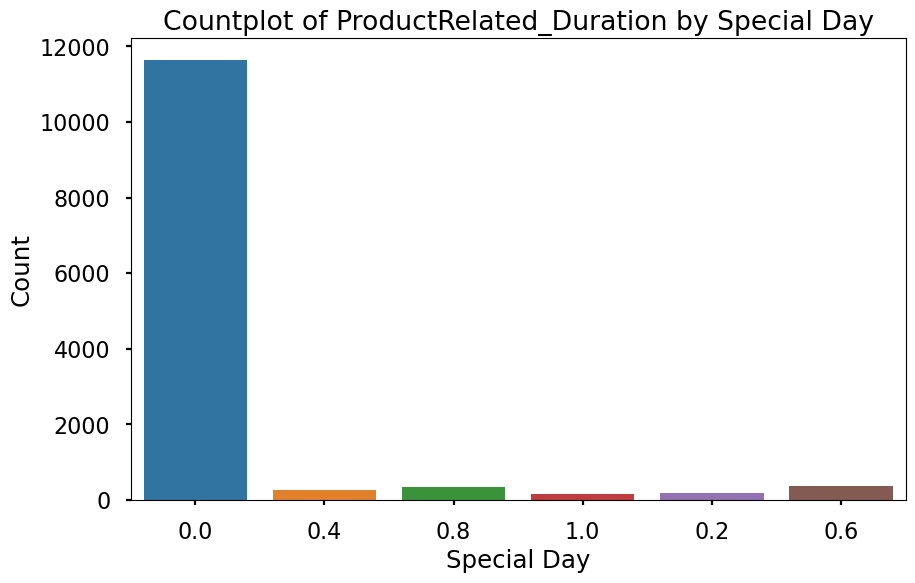

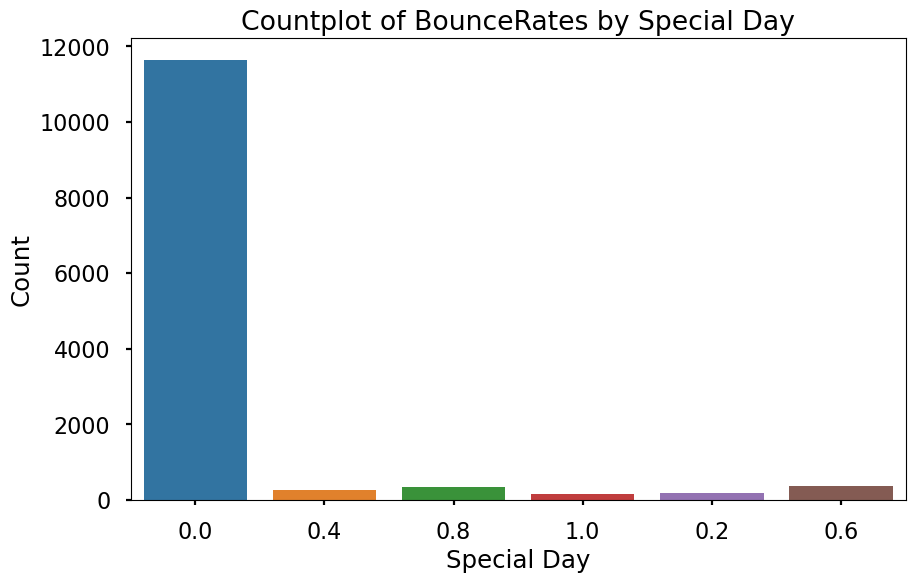

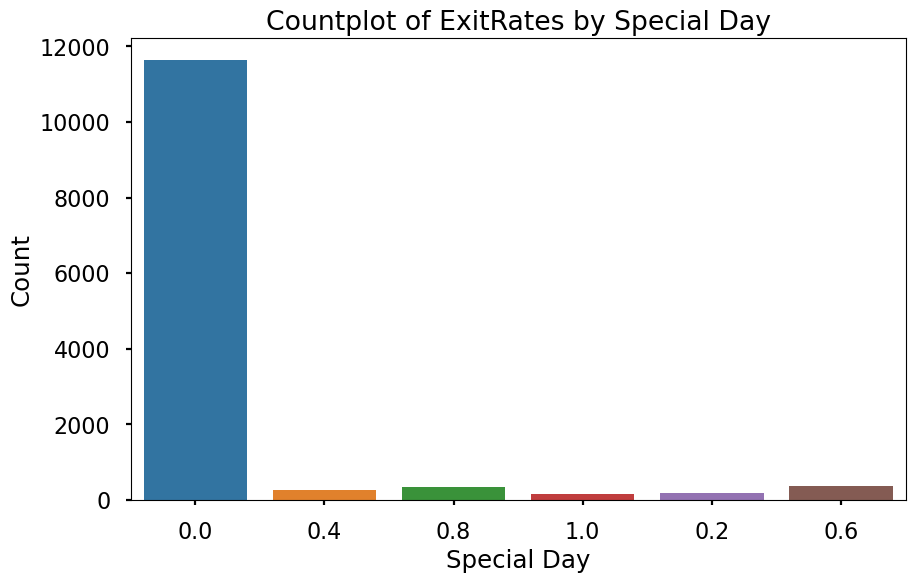

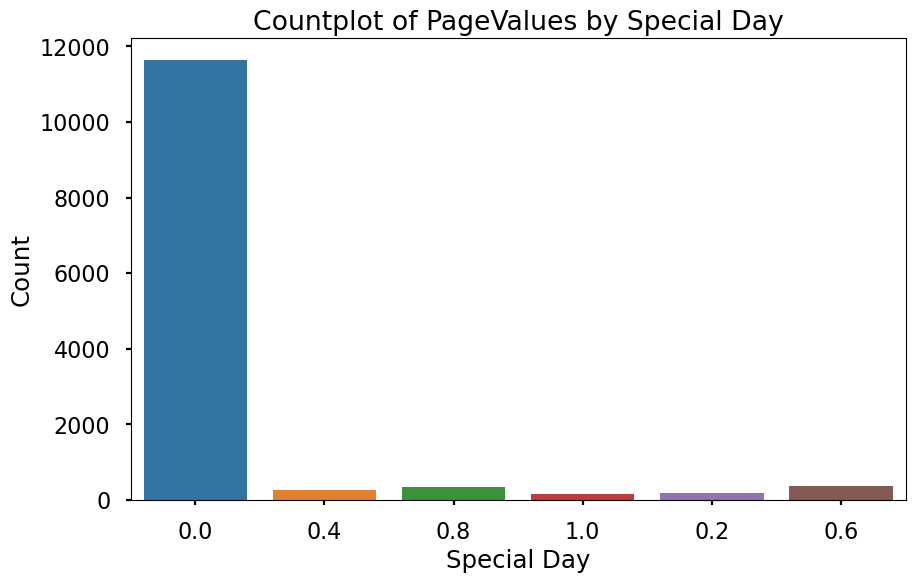

In [74]:
for col in num:
    plt.figure(figsize=(10, 6))
    sns.countplot(x='SpecialDay', data=df_pre, order=df['SpecialDay'].unique())
    plt.title(f'Countplot of {col} by Special Day')
    plt.xlabel('Special Day')
    plt.ylabel('Count')
    plt.show()

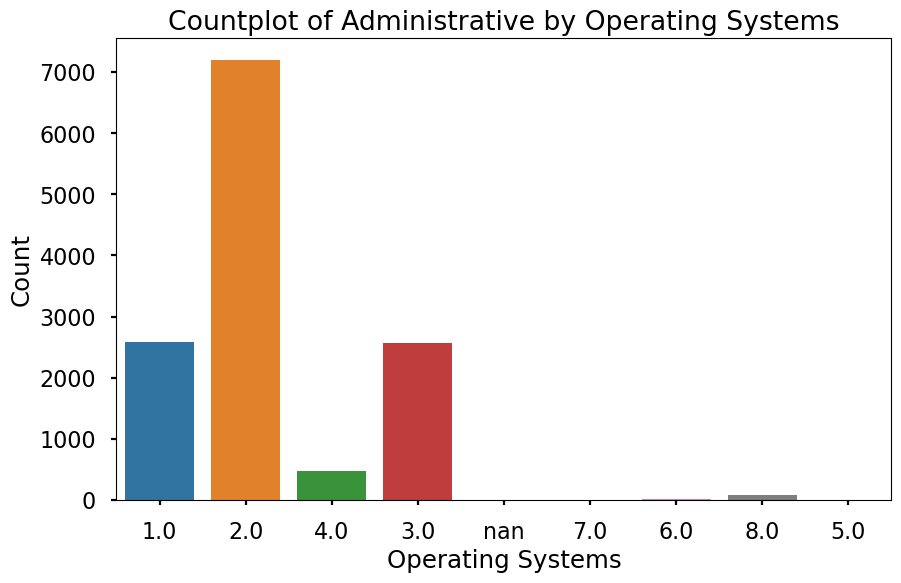

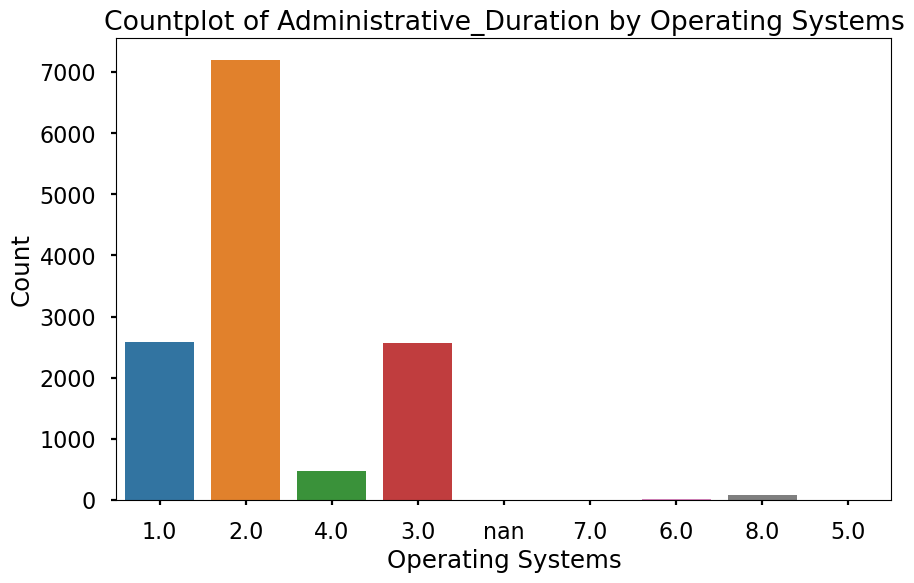

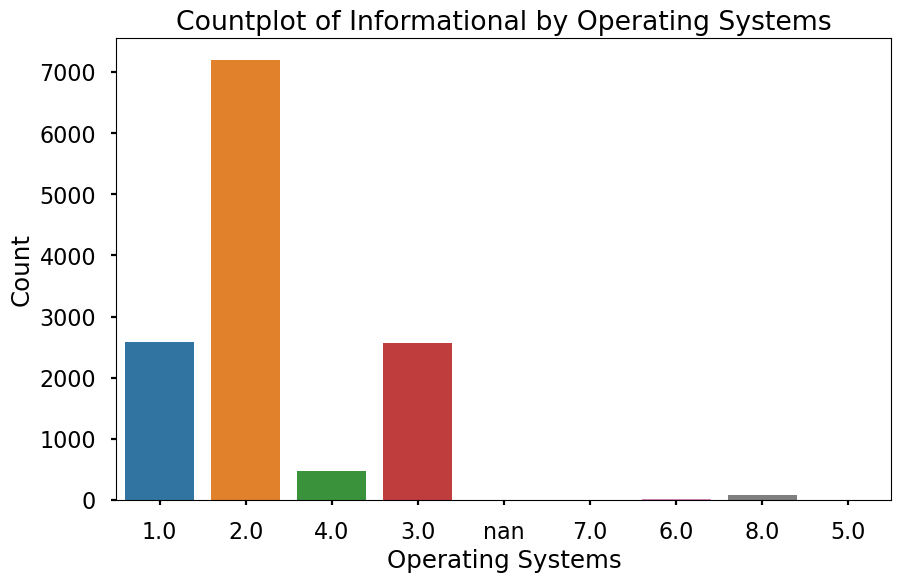

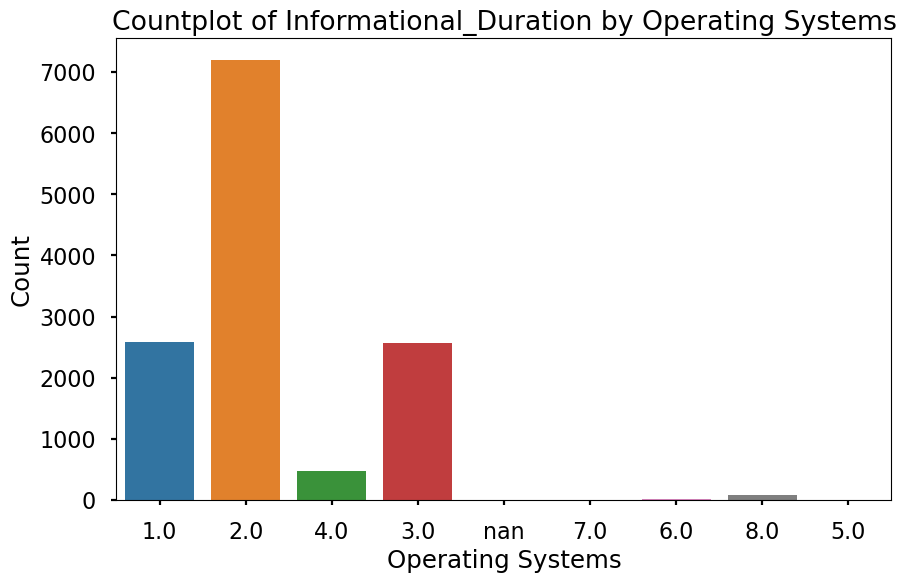

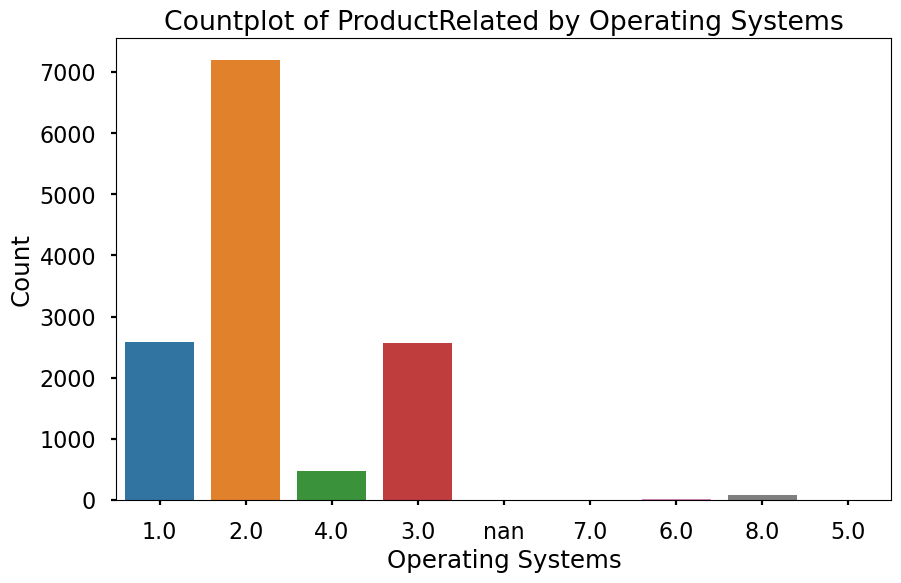

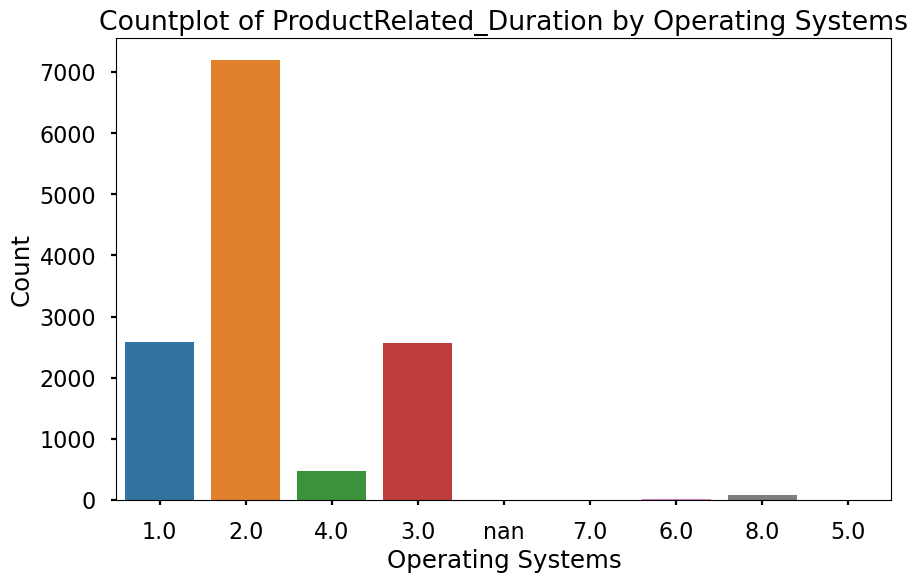

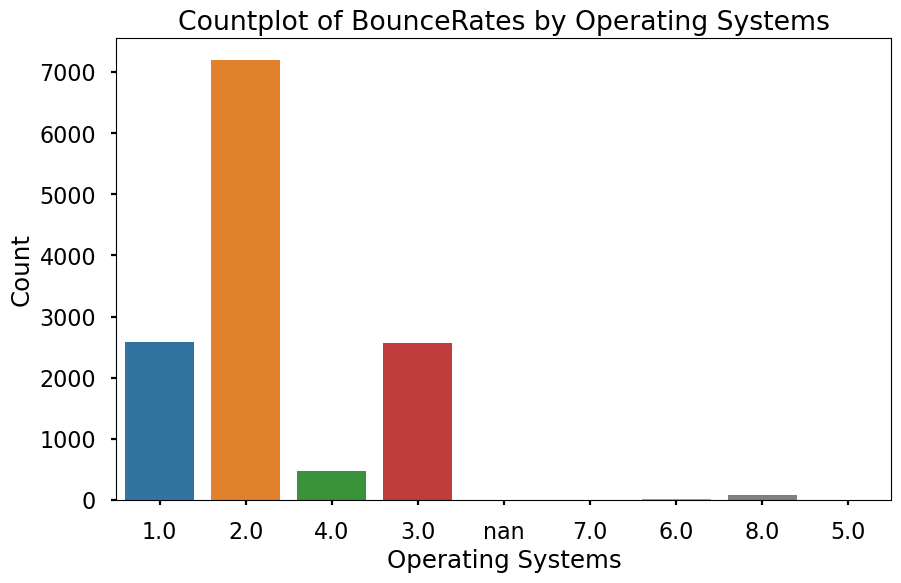

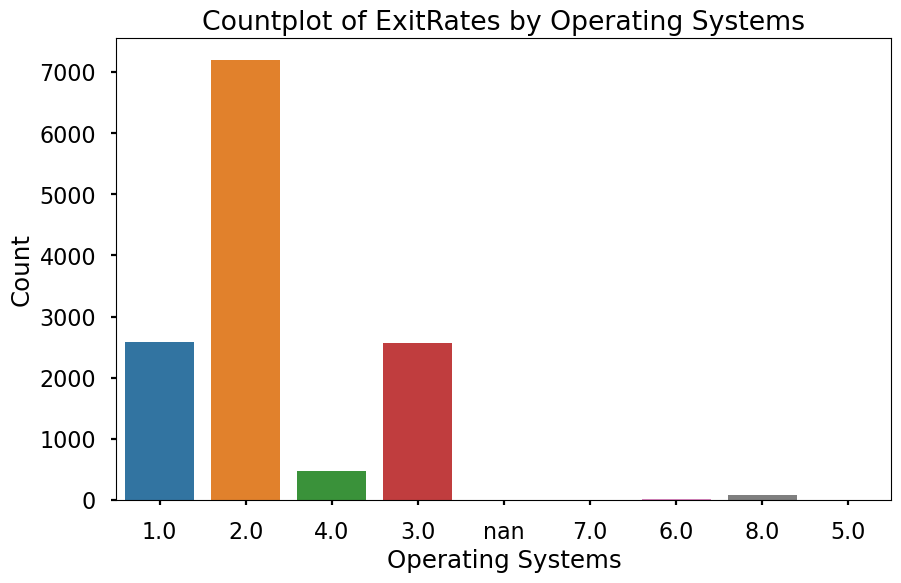

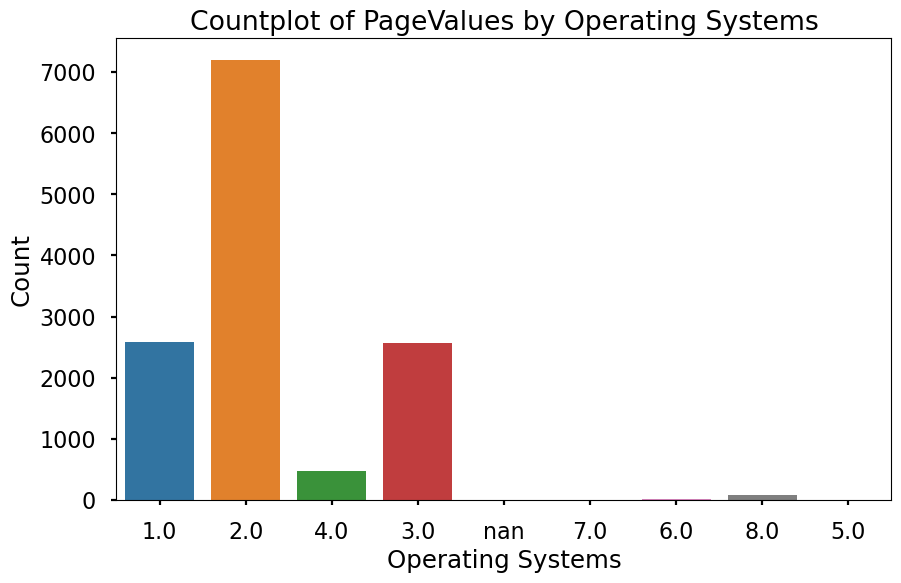

In [75]:
for col in num:
    plt.figure(figsize=(10, 6))
    sns.countplot(x='OperatingSystems', data=df_pre, order=df['OperatingSystems'].unique())
    plt.title(f'Countplot of {col} by Operating Systems')
    plt.xlabel('Operating Systems')
    plt.ylabel('Count')
    plt.show()

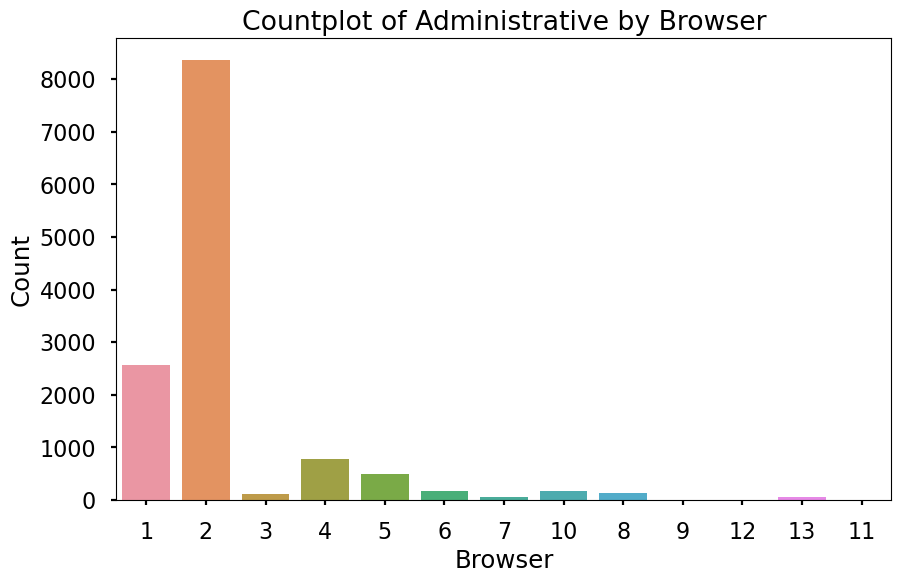

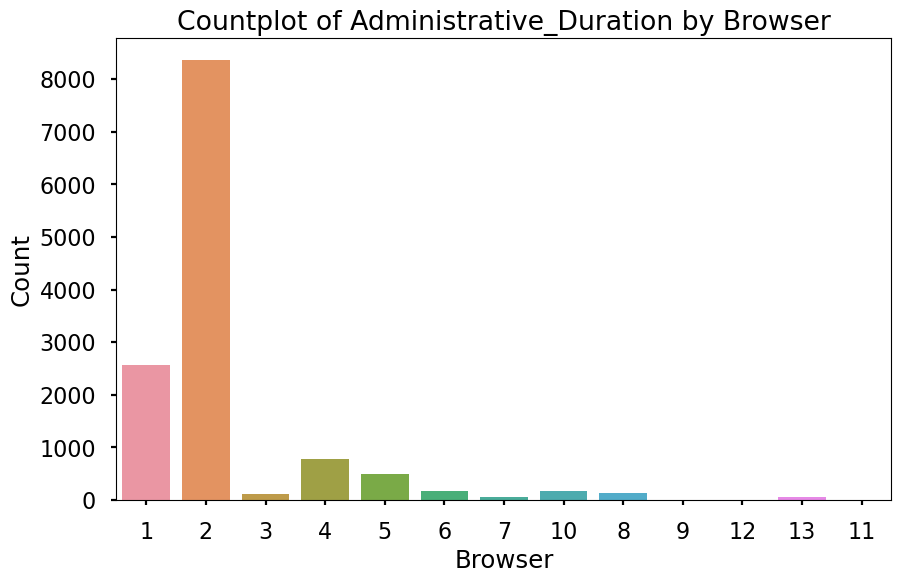

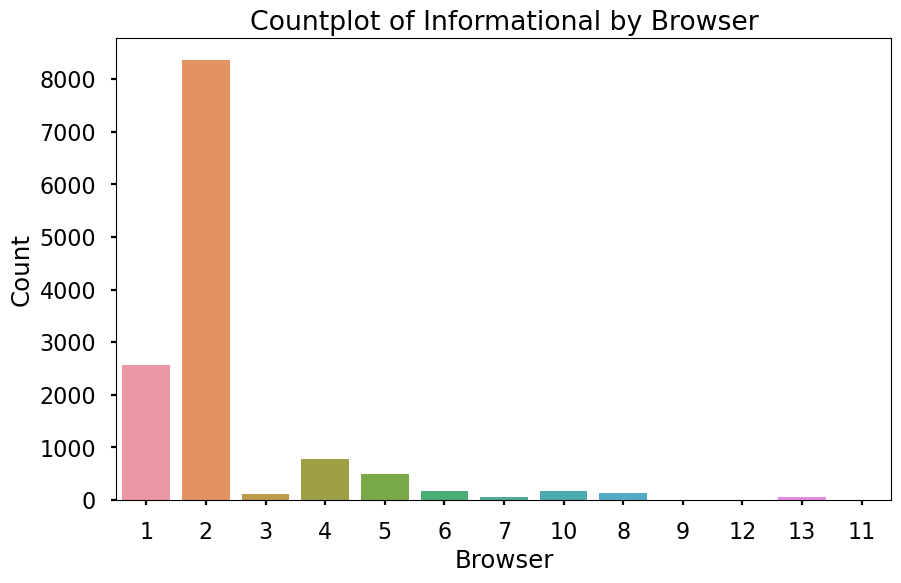

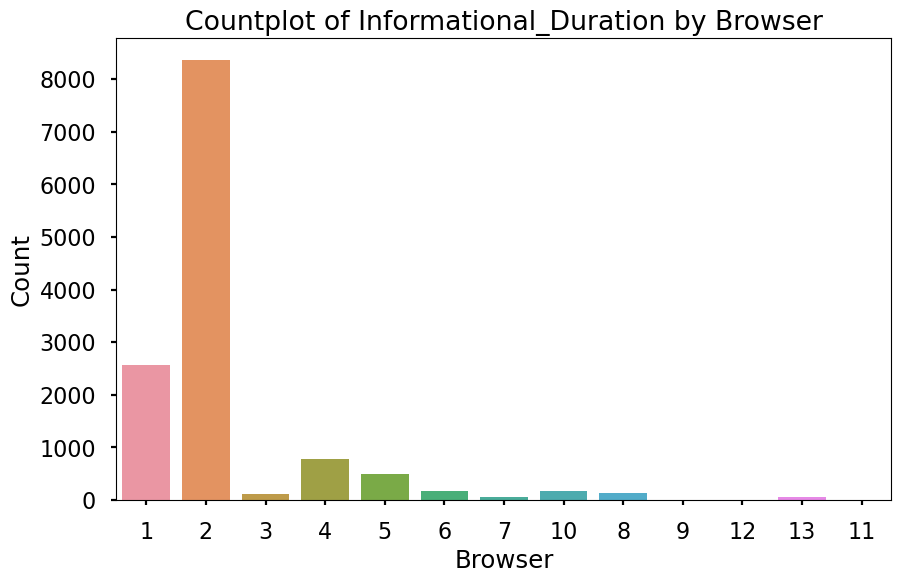

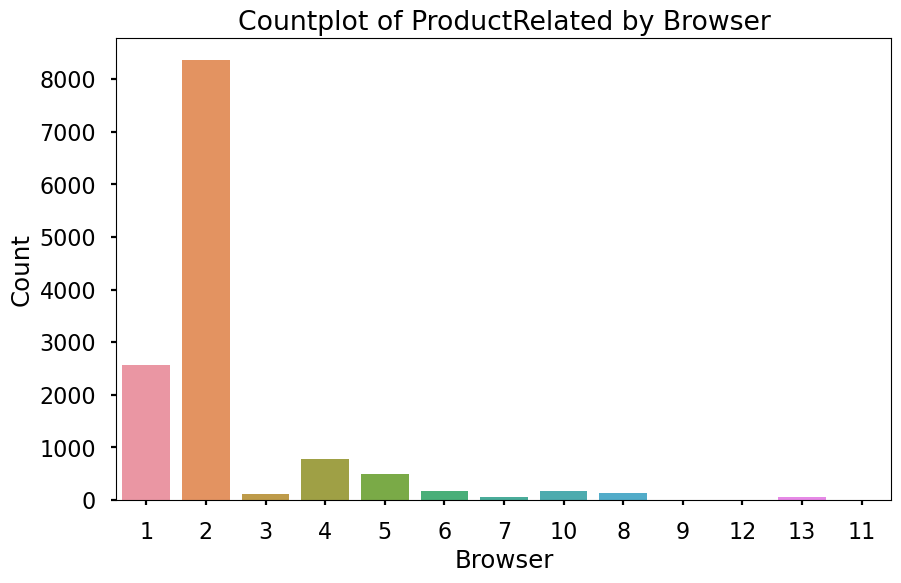

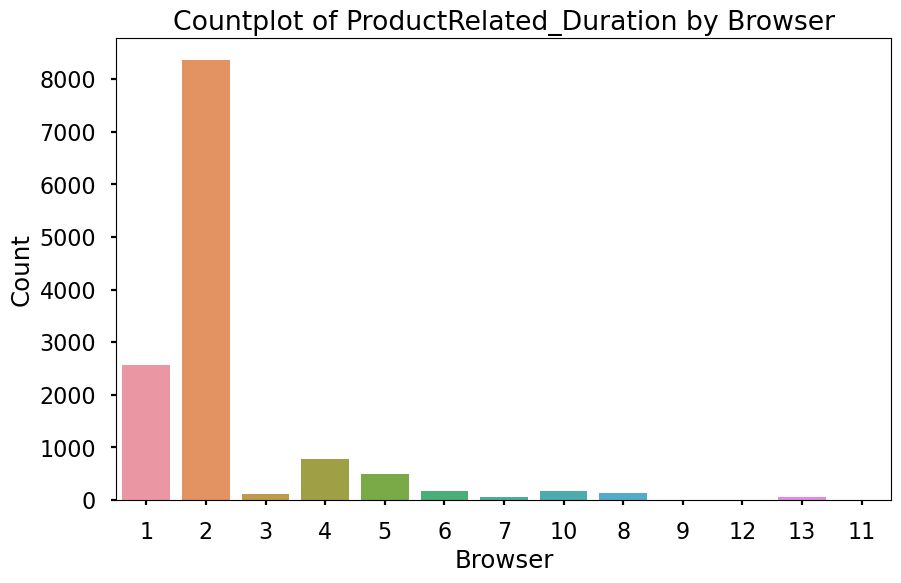

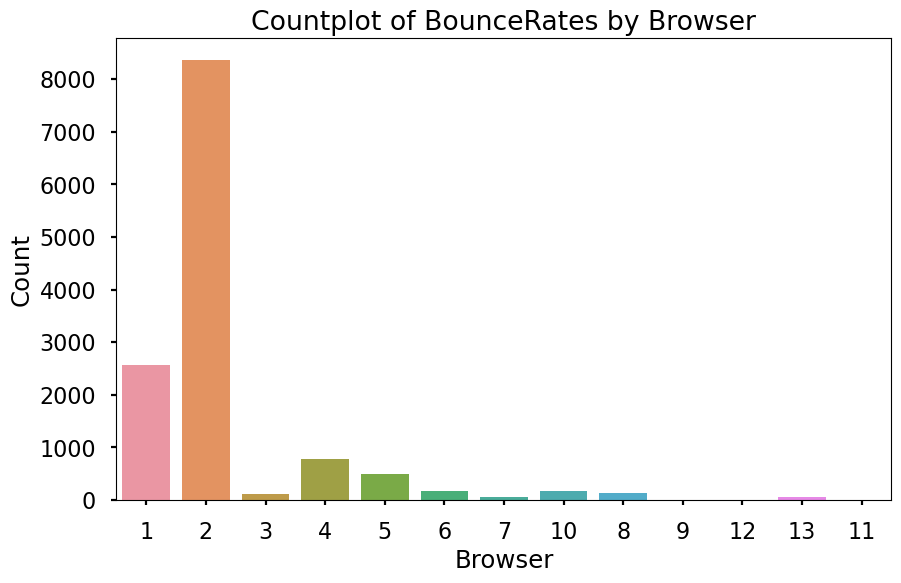

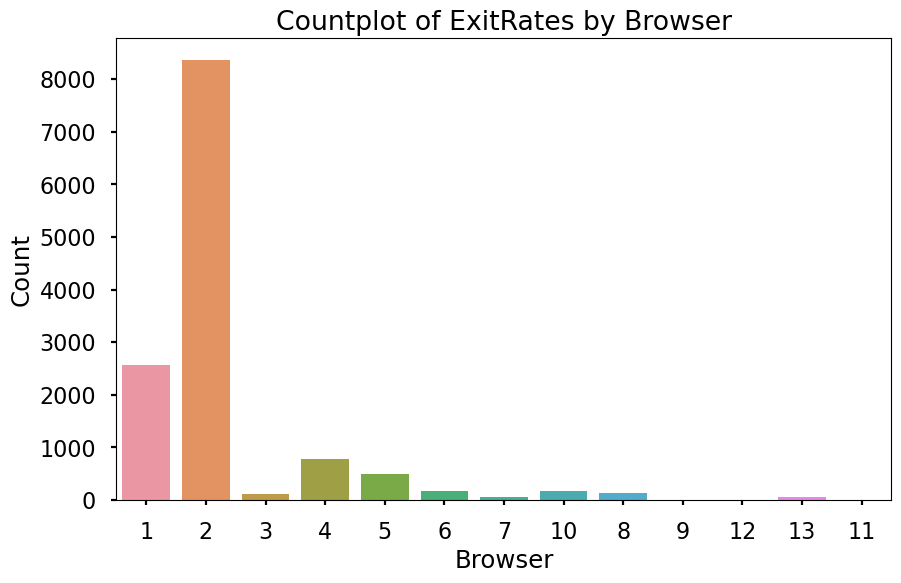

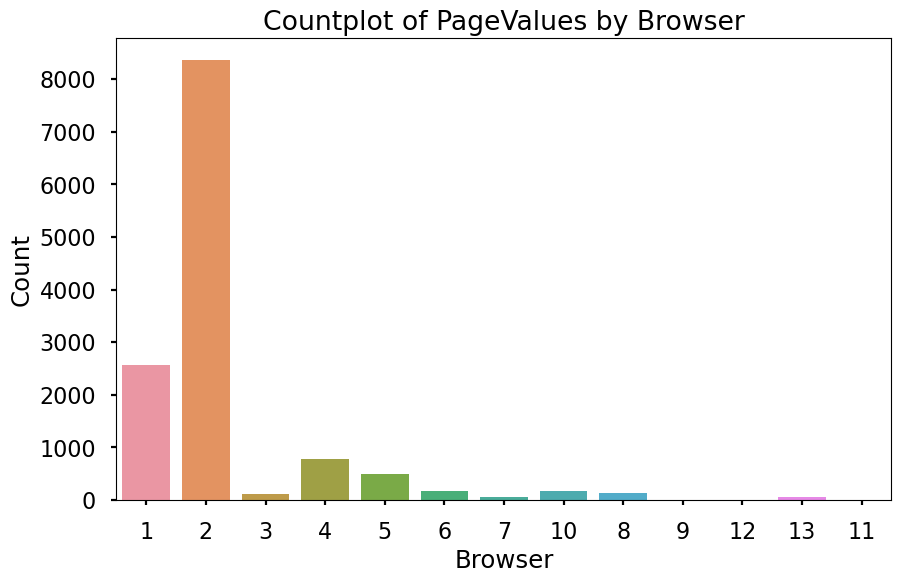

In [76]:
for col in num:
    plt.figure(figsize=(10, 6))
    sns.countplot(x='Browser', data=df_pre, order=df['Browser'].unique())
    plt.title(f'Countplot of {col} by Browser')
    plt.xlabel('Browser')
    plt.ylabel('Count')
    plt.show()

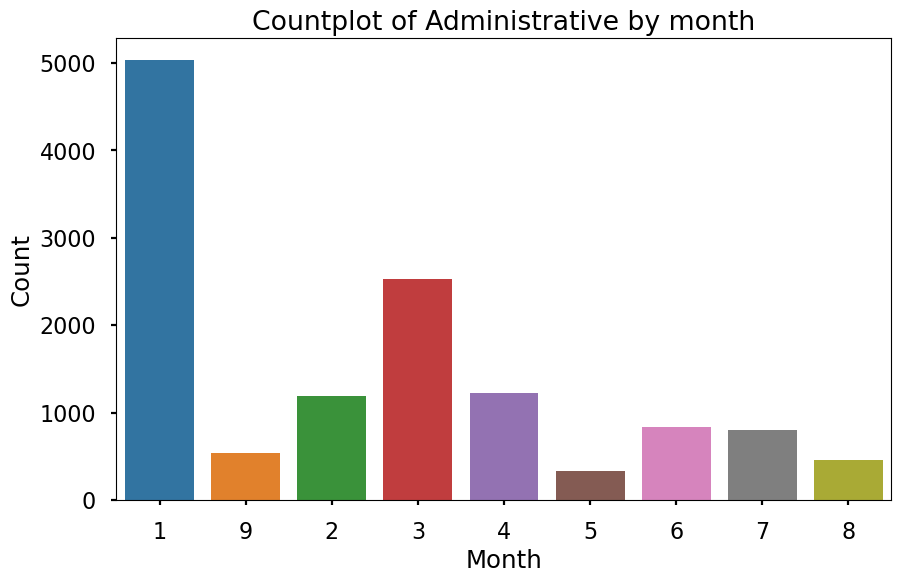

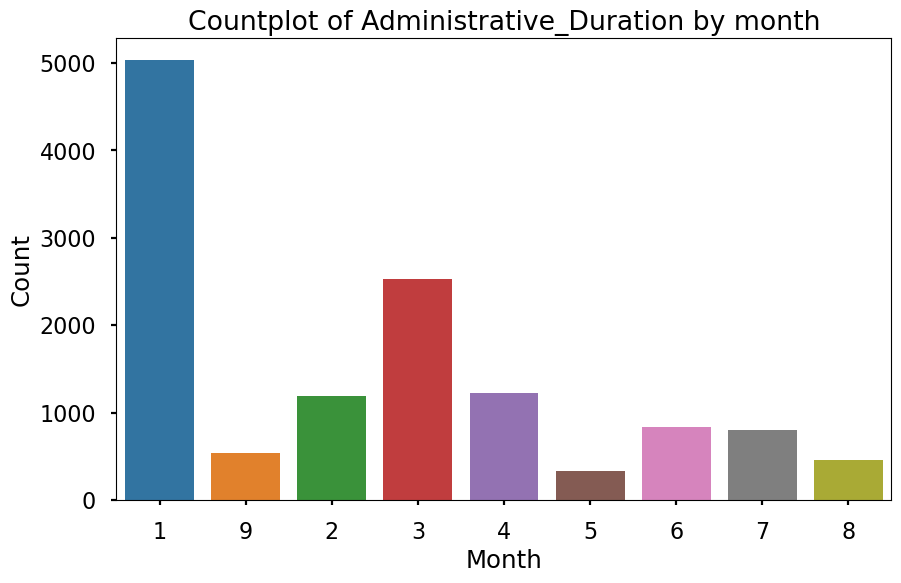

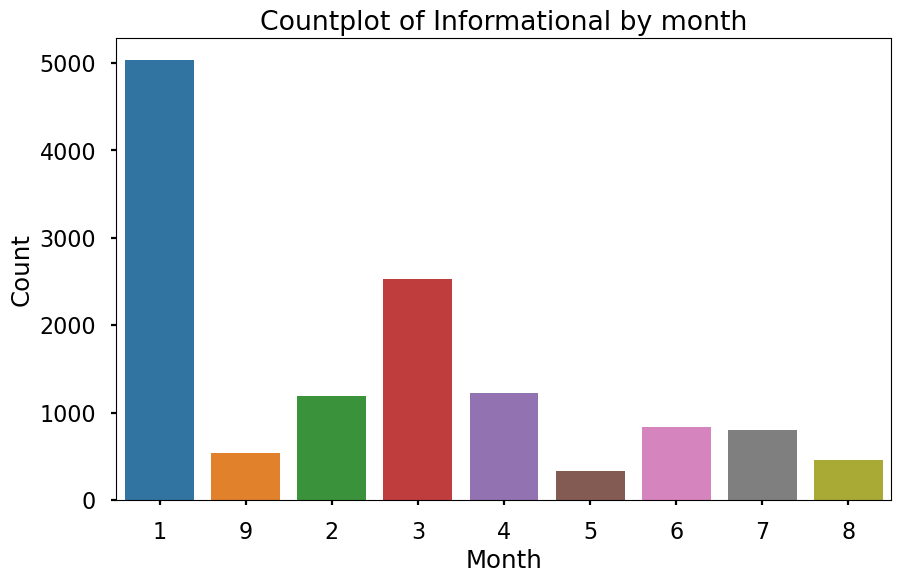

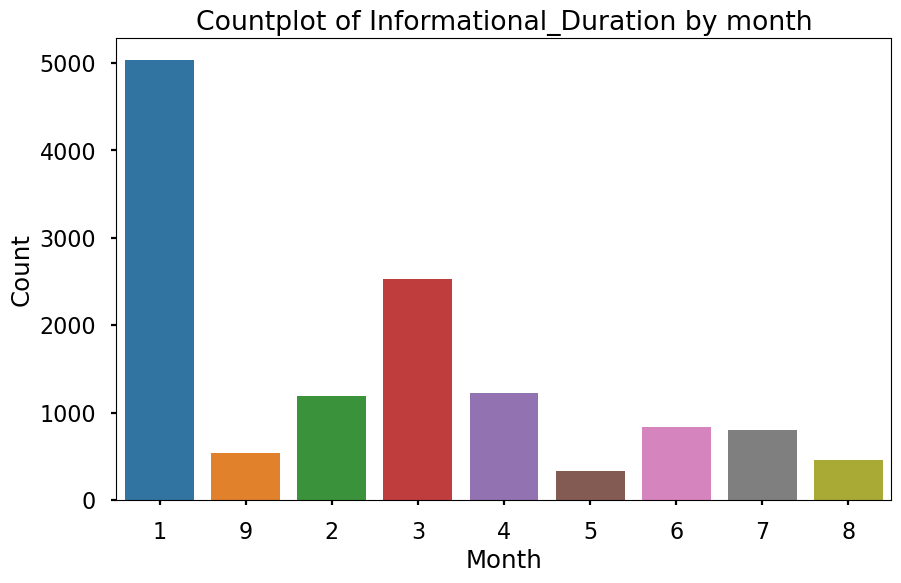

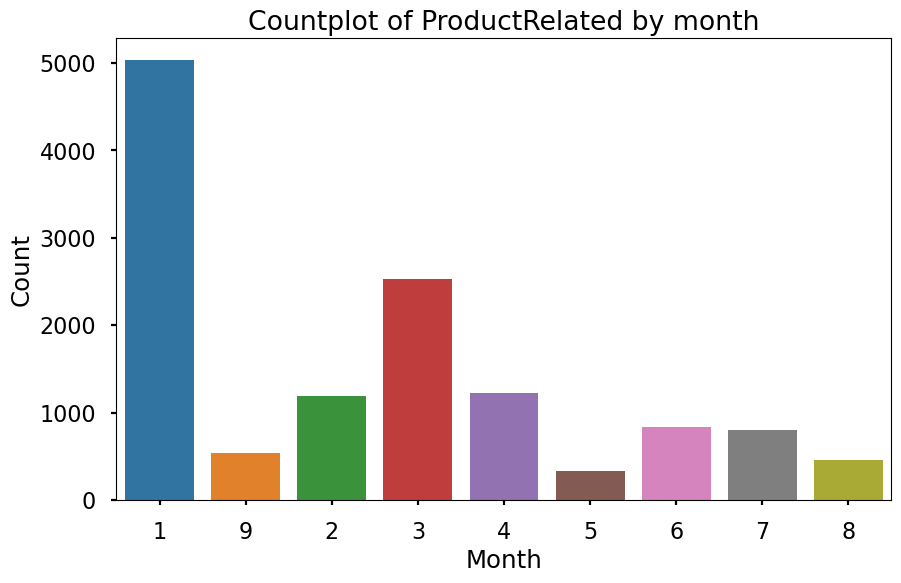

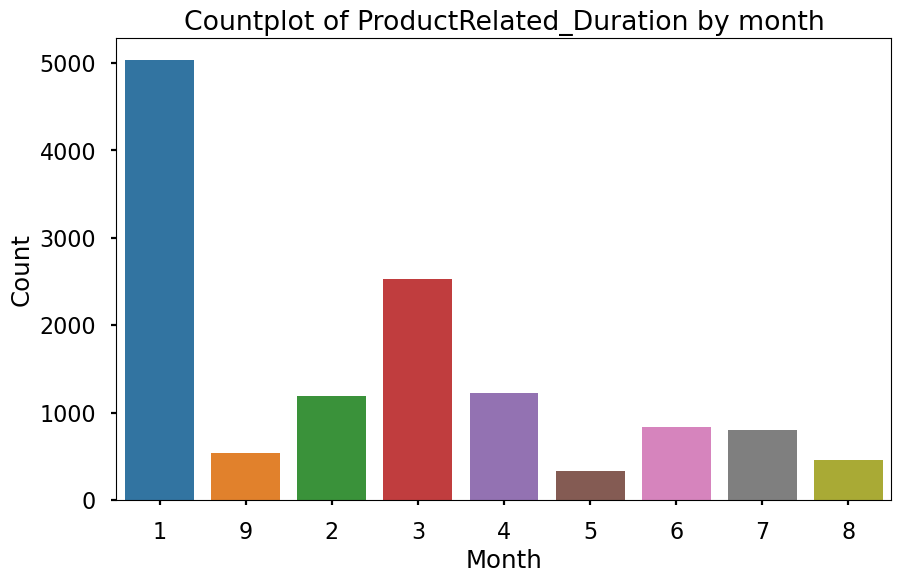

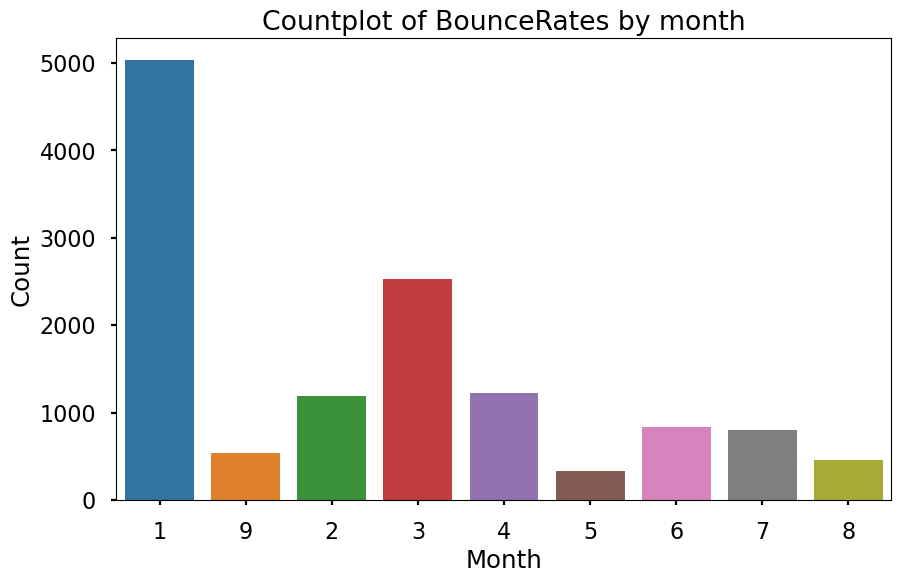

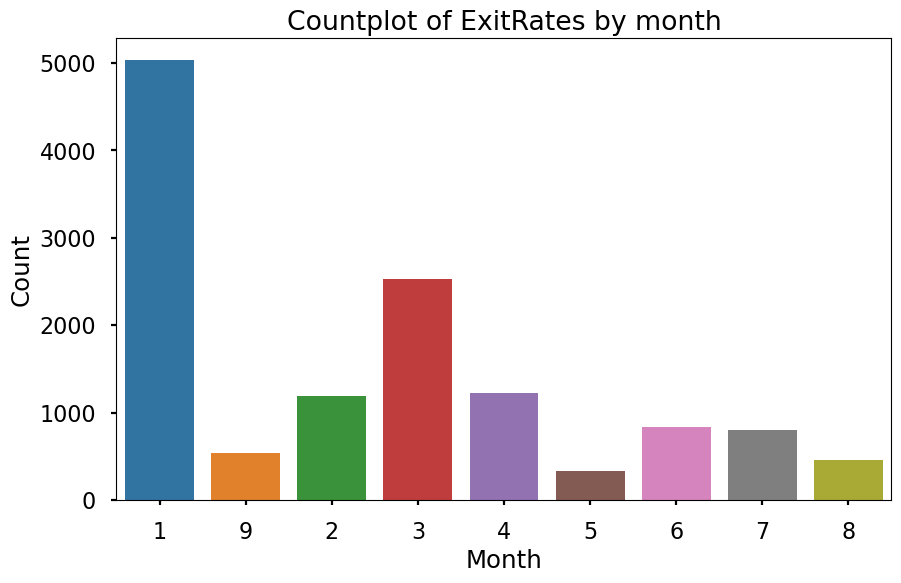

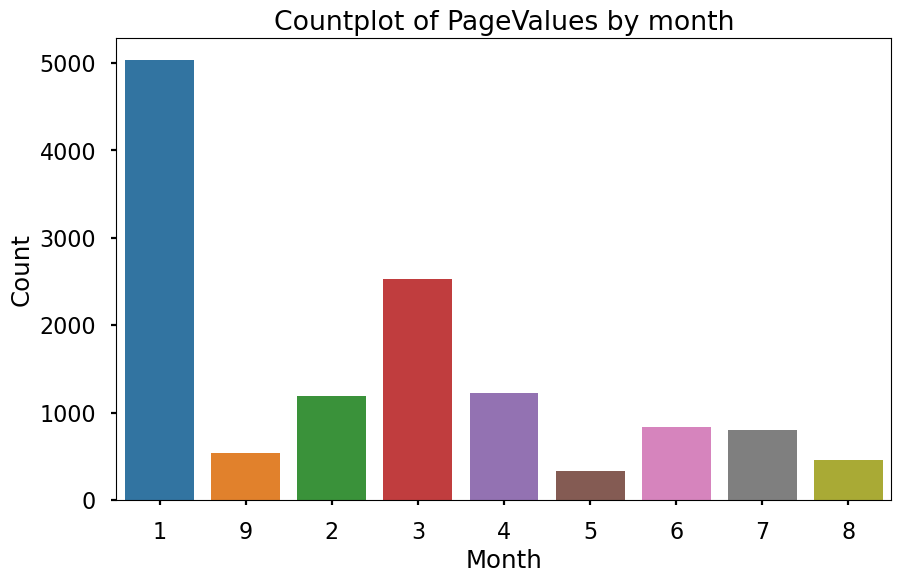

In [71]:
for col in num:
    plt.figure(figsize=(10, 6))
    sns.countplot(x='Region', data=df_pre, order=df['Region'].unique())
    plt.title(f'Countplot of {col} by month')
    plt.xlabel('Month')
    plt.ylabel('Count')
    plt.show()

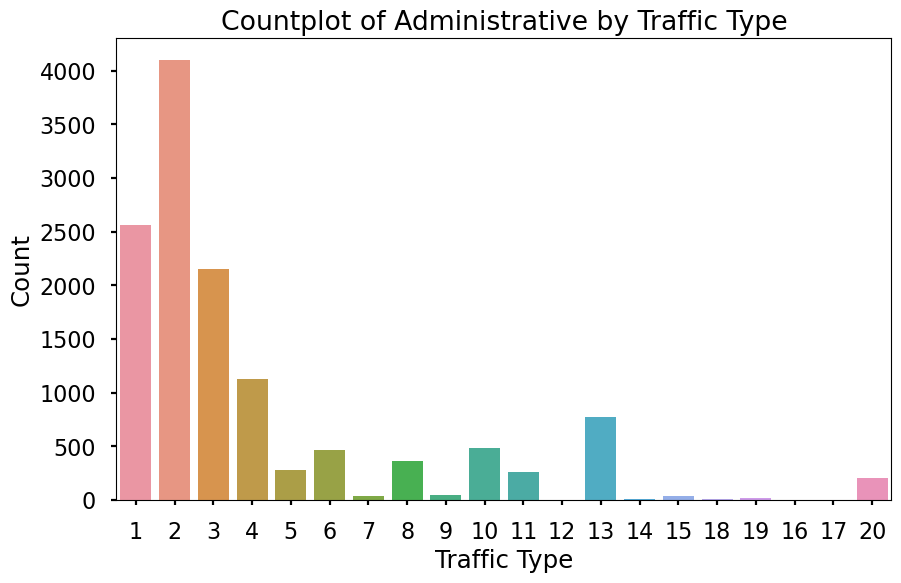

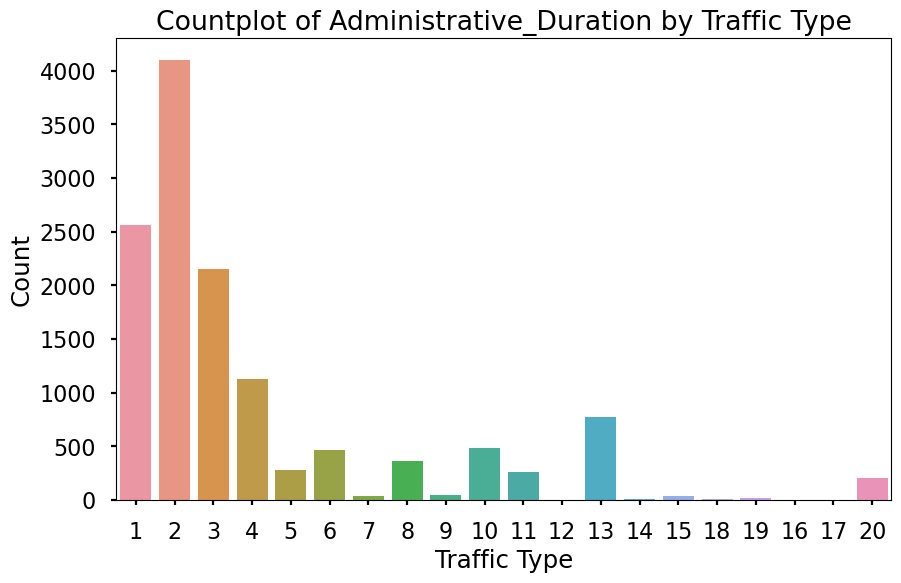

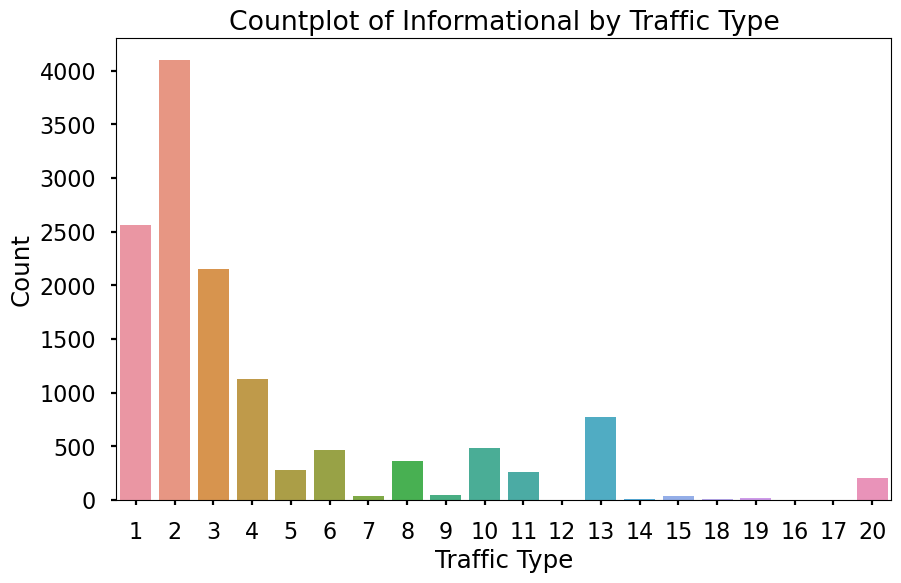

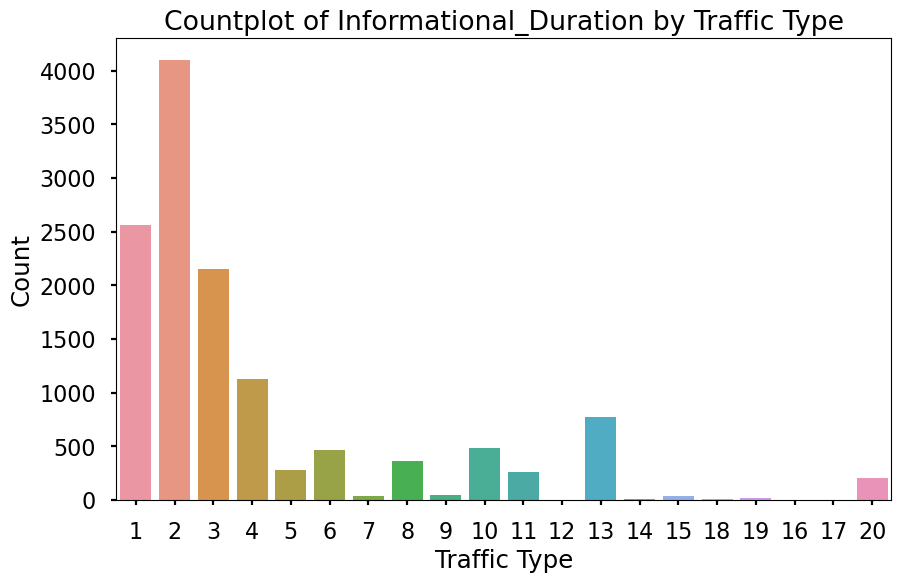

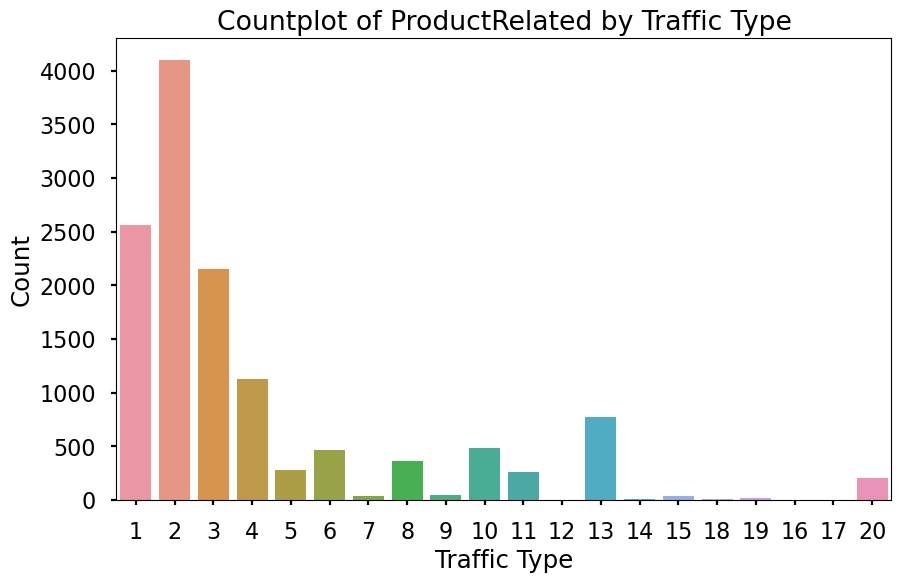

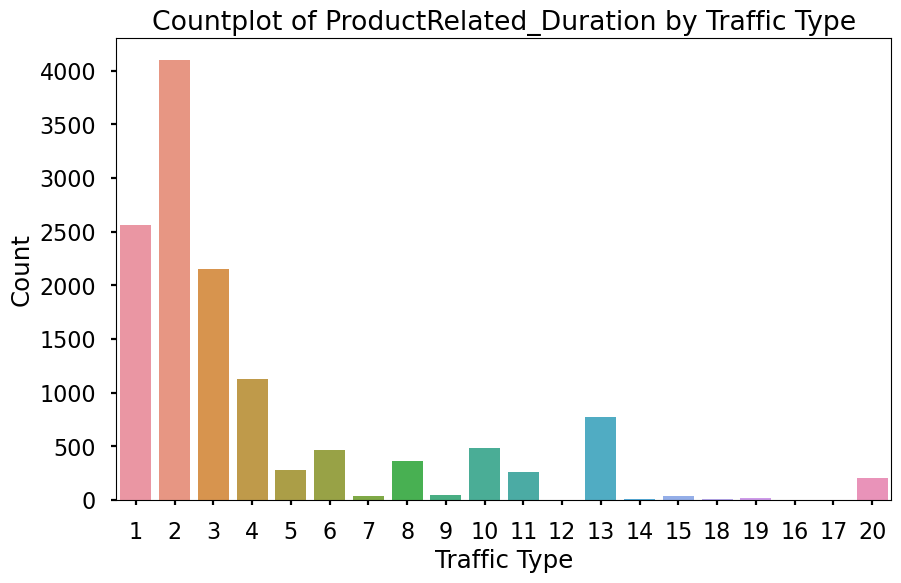

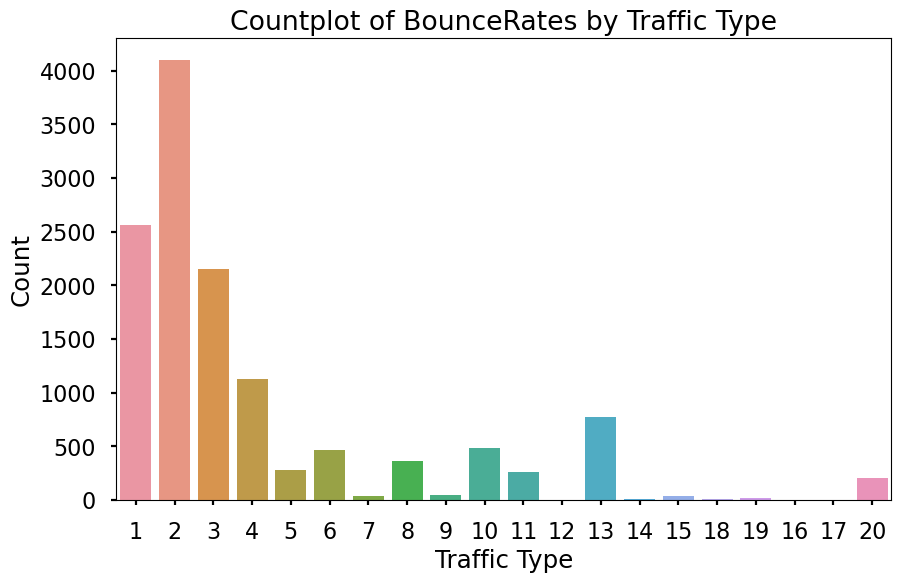

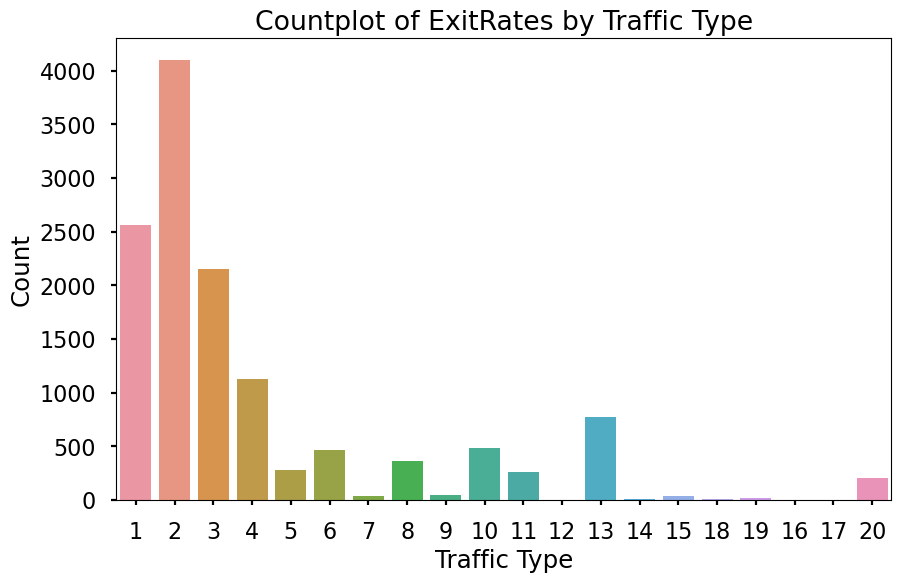

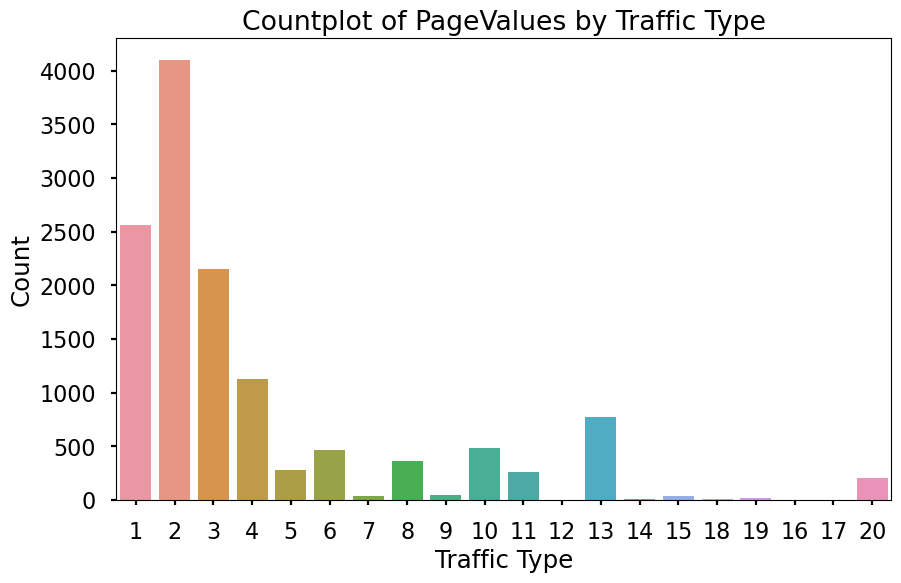

In [77]:
for col in num:
    plt.figure(figsize=(10, 6))
    sns.countplot(x='TrafficType', data=df_pre, order=df['TrafficType'].unique())
    plt.title(f'Countplot of {col} by Traffic Type')
    plt.xlabel('Traffic Type')
    plt.ylabel('Count')
    plt.show()

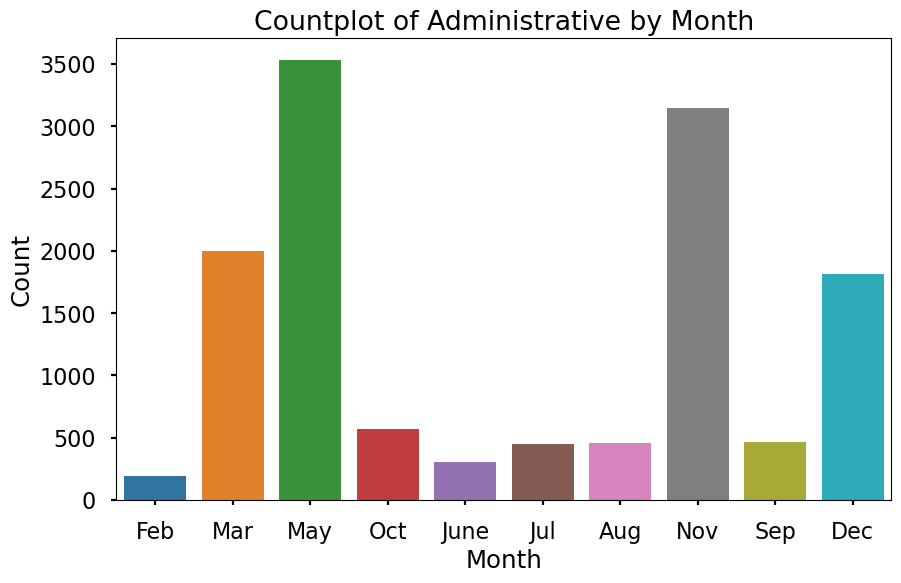

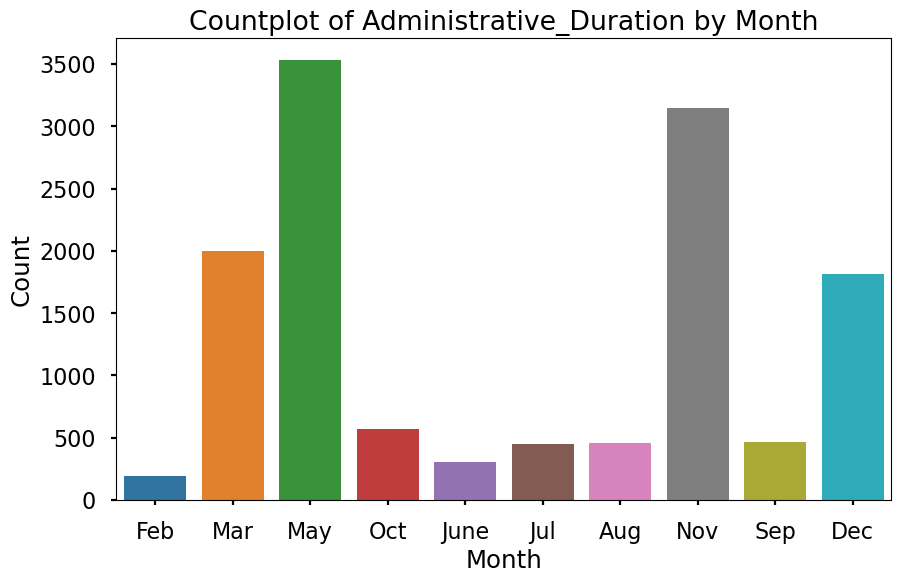

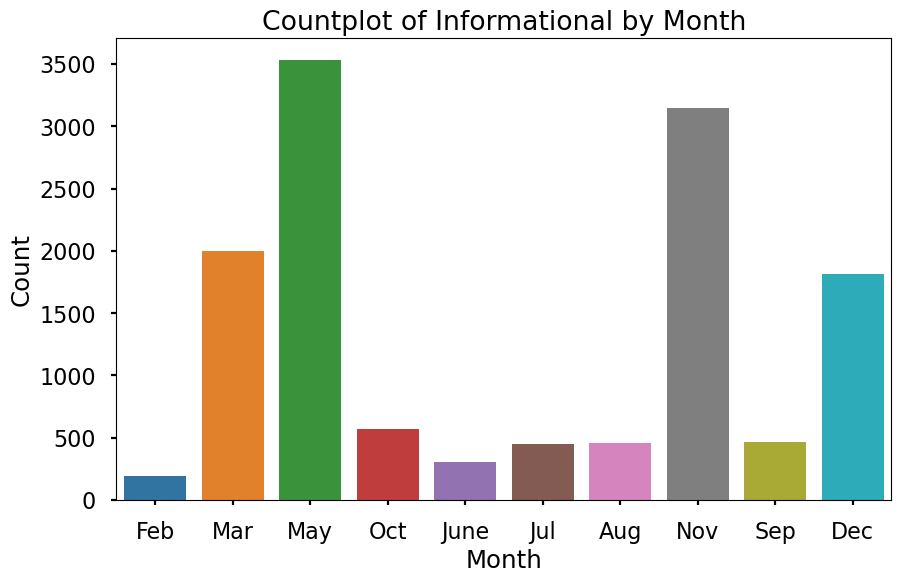

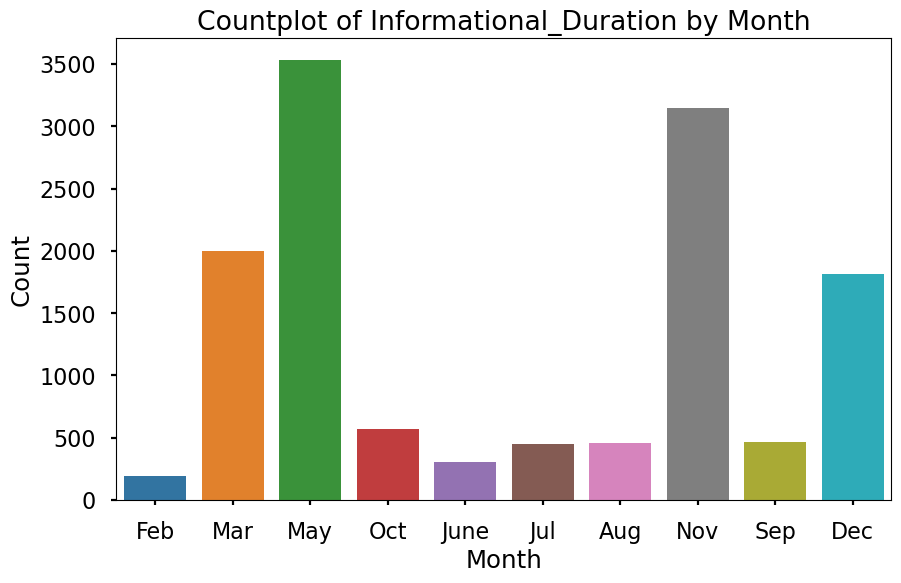

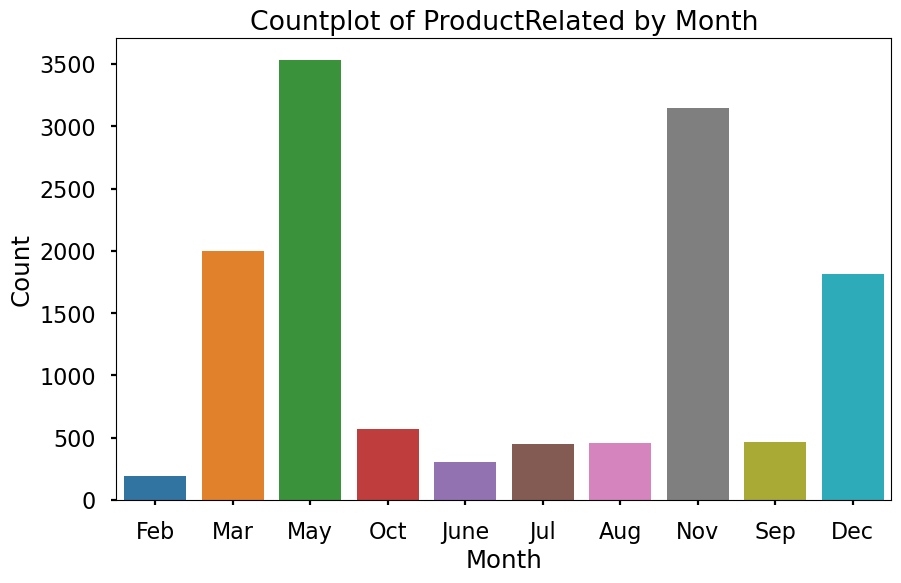

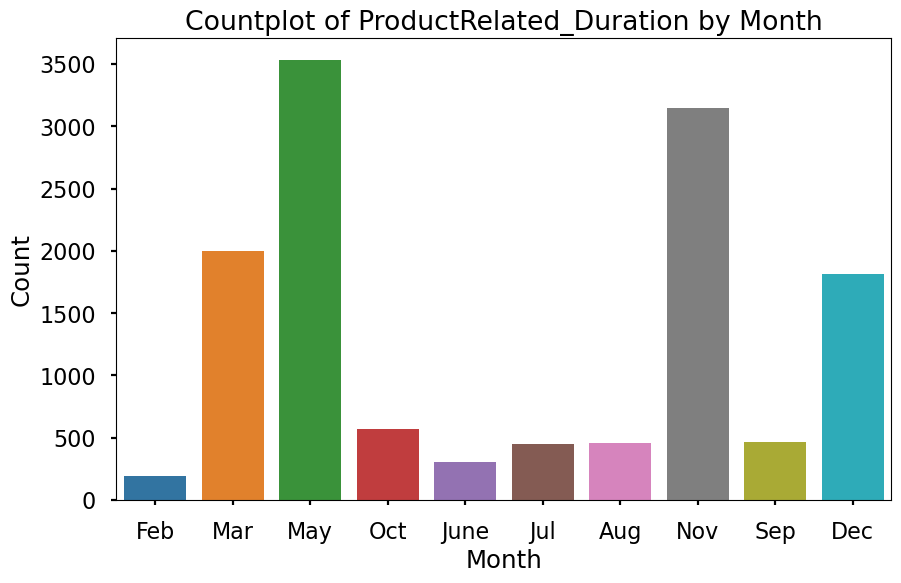

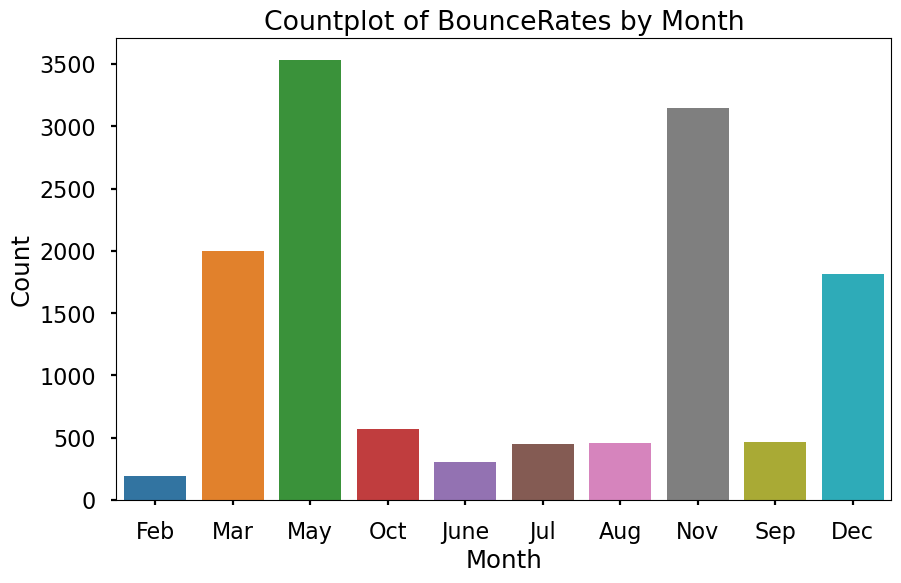

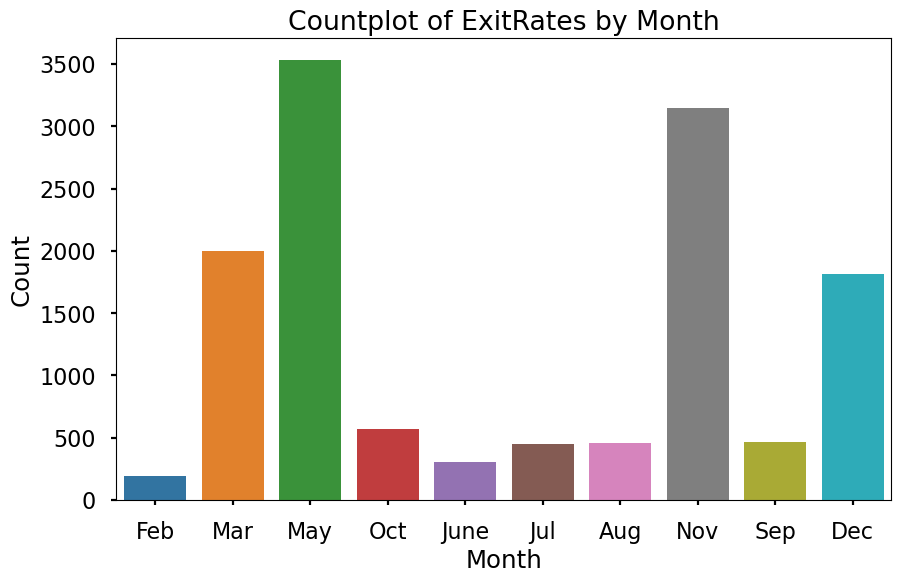

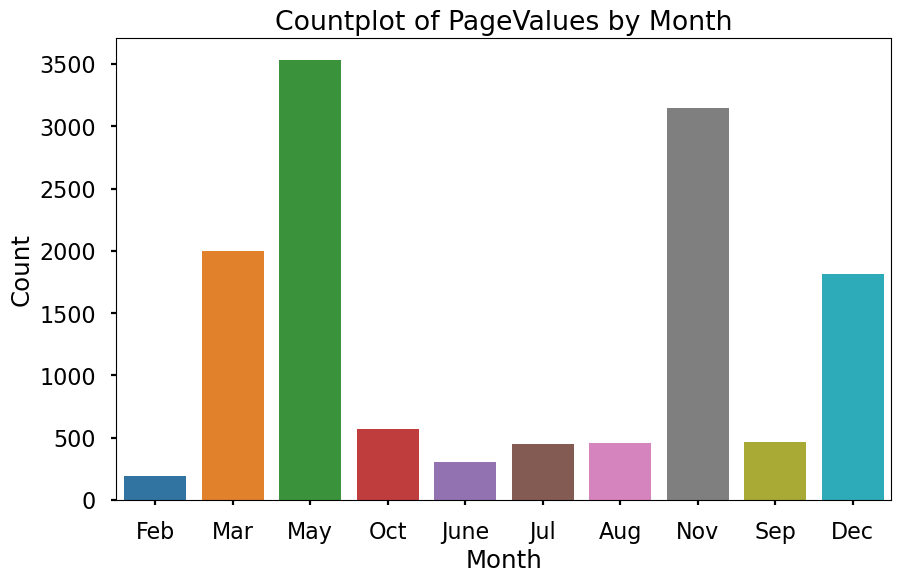

In [79]:
for col in num:
    plt.figure(figsize=(10, 6))
    sns.countplot(x='Month', data=df_pre, order=df['Month'].unique())
    plt.title(f'Countplot of {col} by Month')
    plt.xlabel('Month')
    plt.ylabel('Count')
    plt.show()

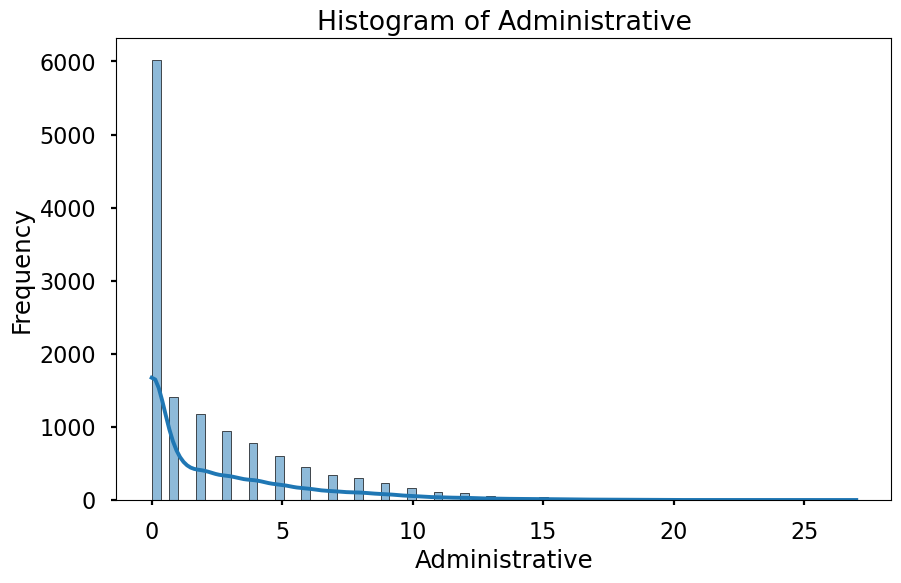

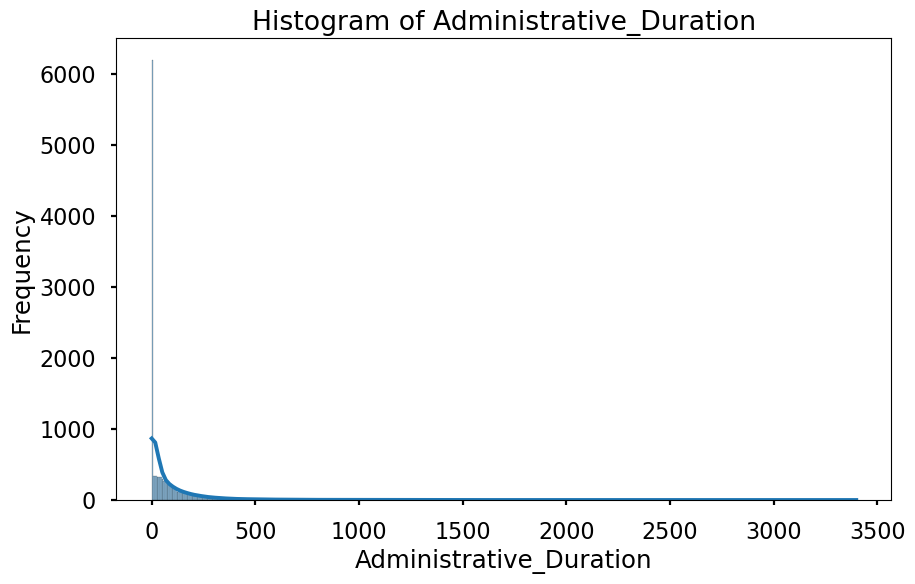

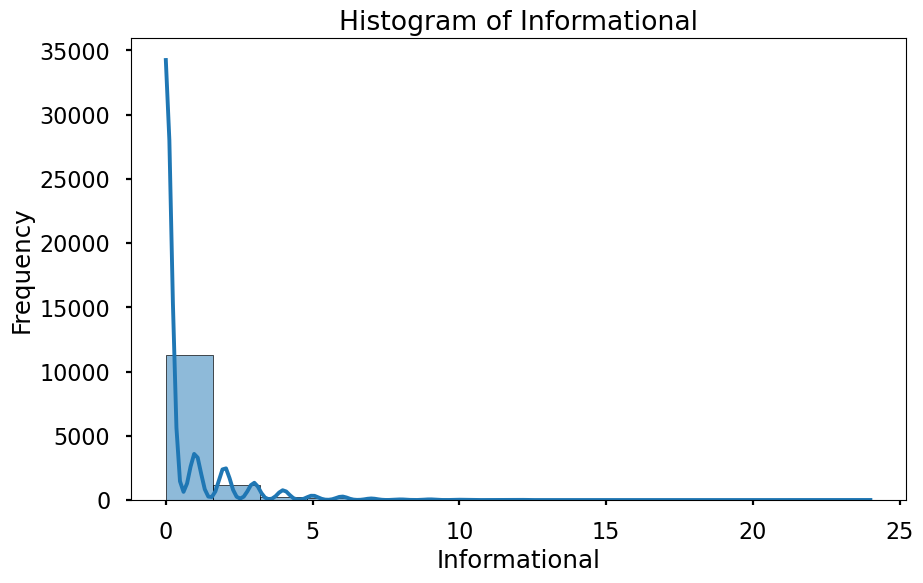

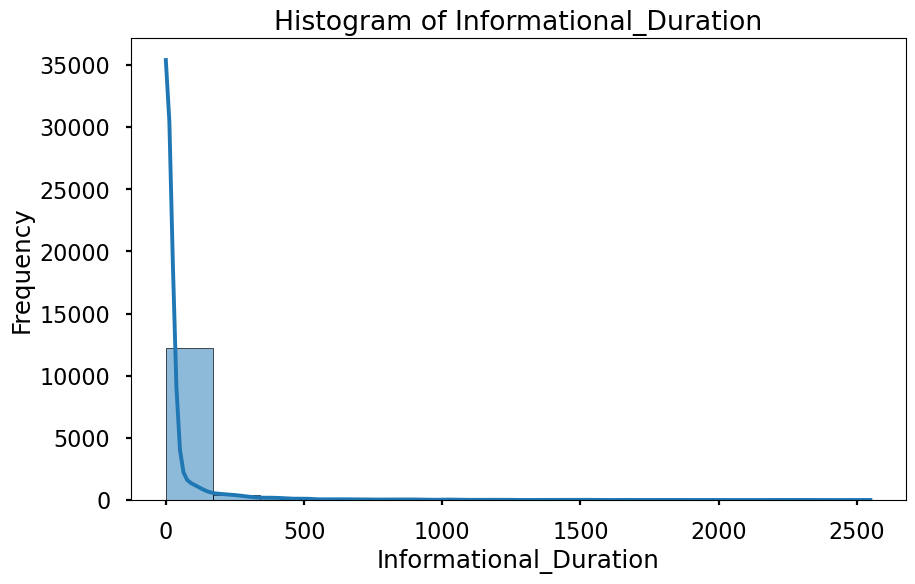

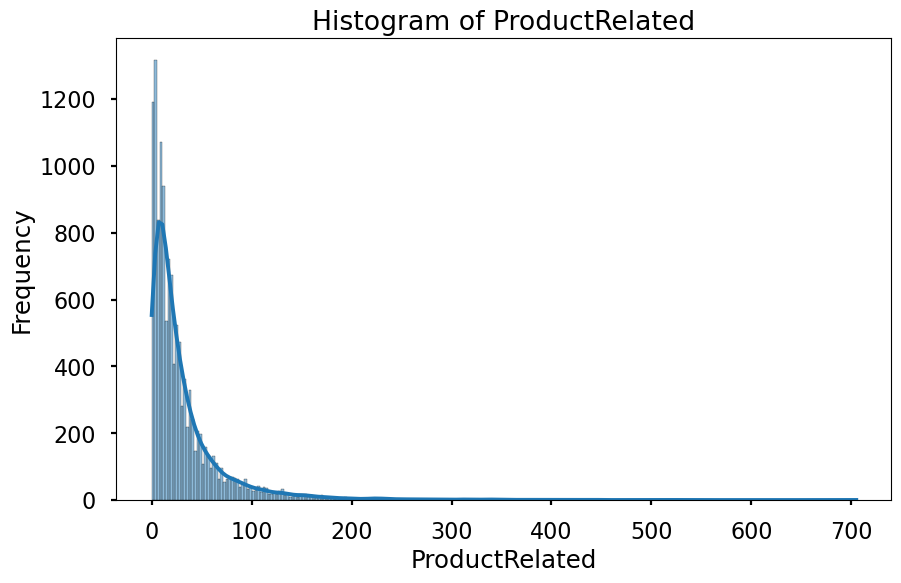

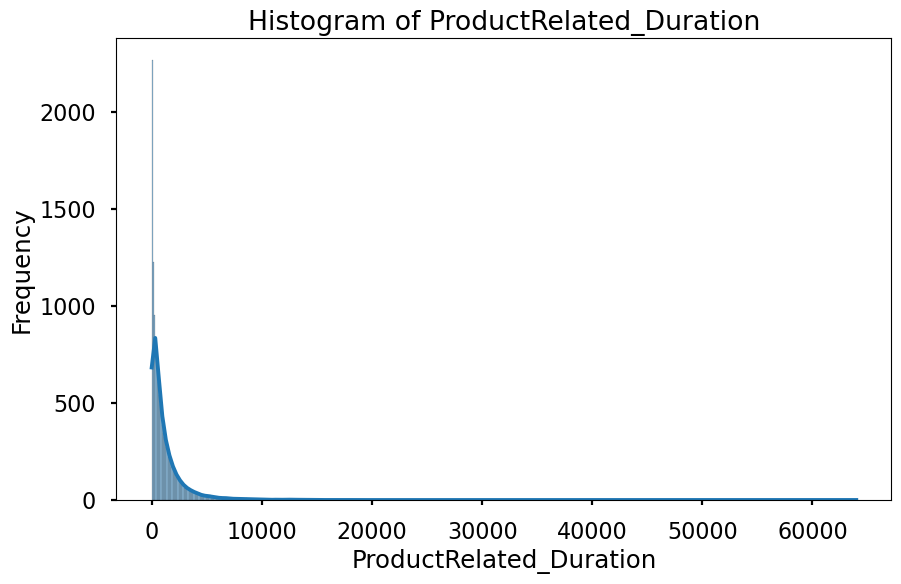

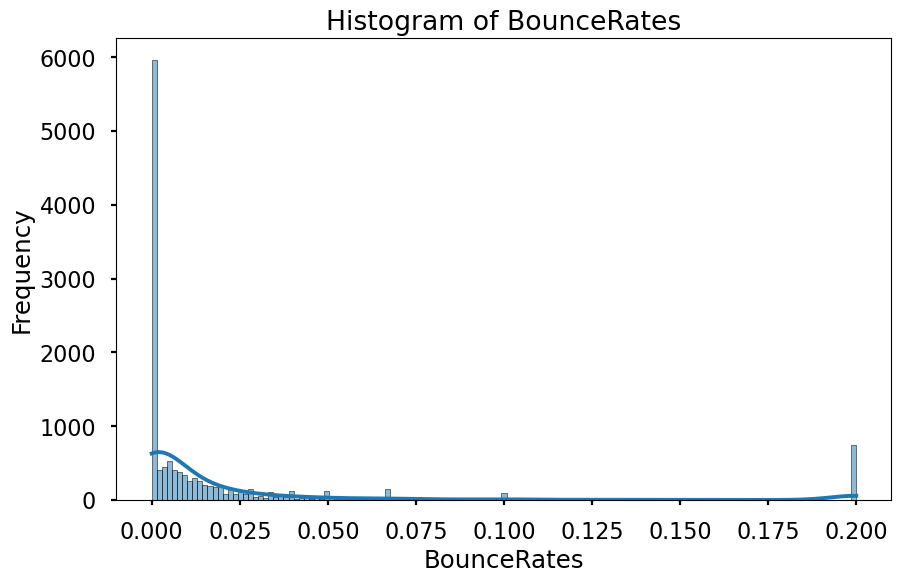

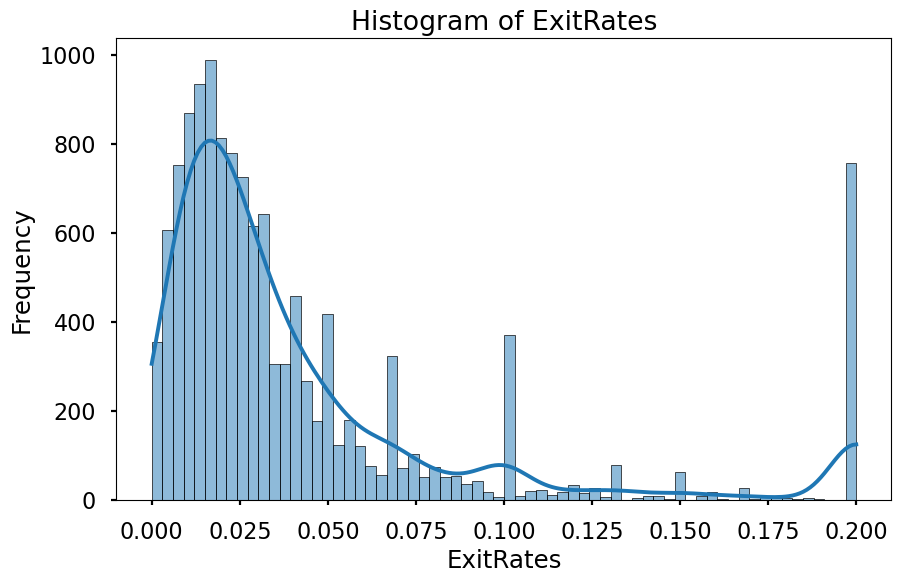

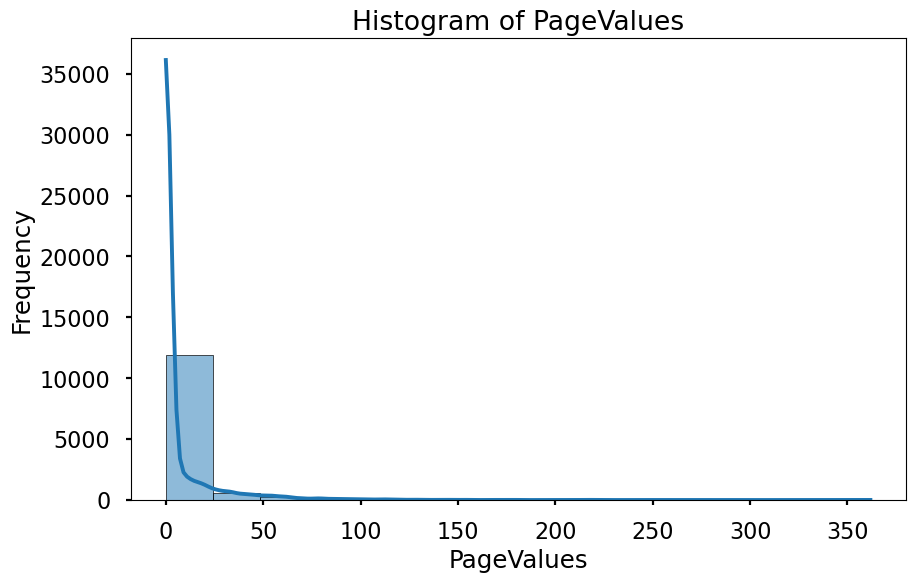

In [81]:
# Plot histogram untuk kolom numerik
for col in num:
    plt.figure(figsize=(10, 6))
    sns.histplot(data=df, x=col, kde=True)
    plt.title(f'Histogram of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

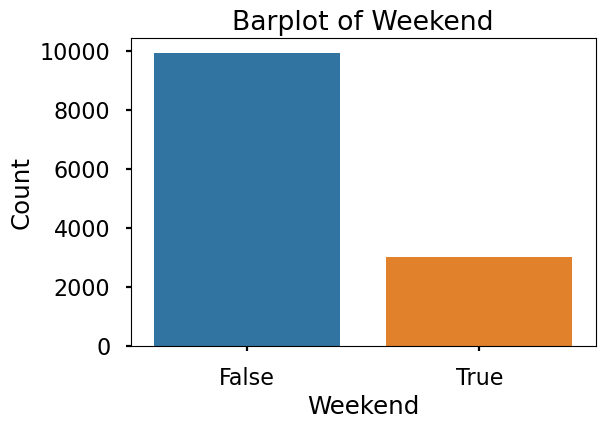

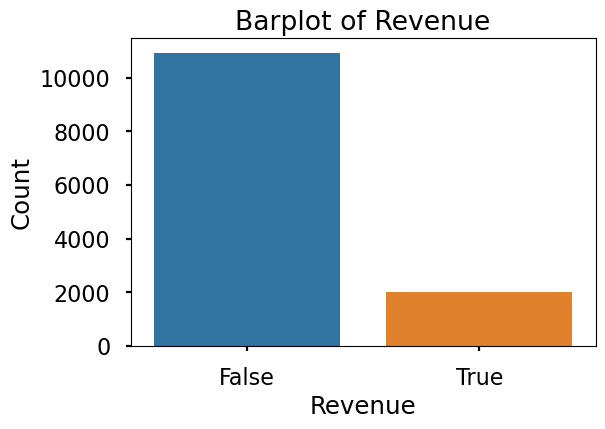

In [82]:
ppp = ['Weekend', 'Revenue']
for col in ppp:
    plt.figure(figsize=(6, 4))
    sns.countplot(x=col, data=df)
    plt.title(f'Barplot of {col}')
    plt.xlabel(col)
    plt.ylabel('Count')
    plt.show()

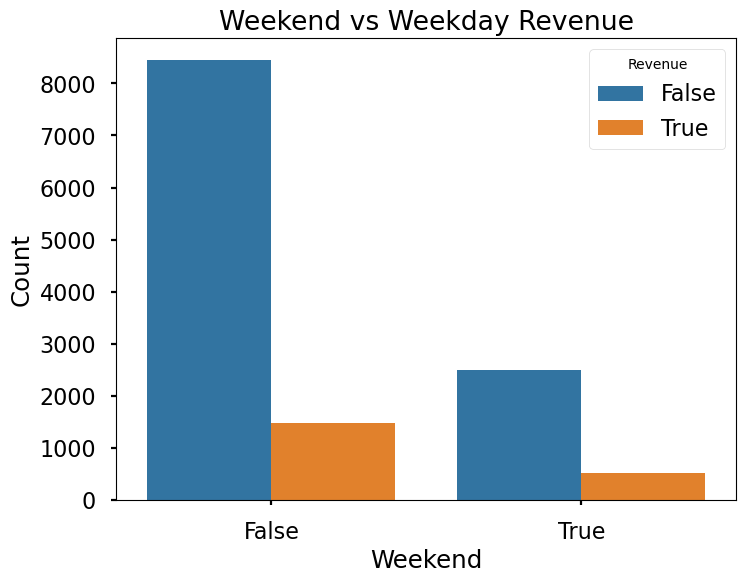

In [83]:
plt.figure(figsize=(8, 6))
sns.countplot(x='Weekend', hue='Revenue', data=df)
plt.title('Weekend vs Weekday Revenue')
plt.xlabel('Weekend')
plt.ylabel('Count')
plt.show()

In [86]:
num

['Administrative',
 'Administrative_Duration',
 'Informational',
 'Informational_Duration',
 'ProductRelated',
 'ProductRelated_Duration',
 'BounceRates',
 'ExitRates',
 'PageValues']